In [38]:
# Notebook to run UMAP on the input abundance profiles
# conda environment: analyse_data_python
import pandas as pd
import sys

sys.path.append("../")

from functions import get_data, merge_data
import umap
import umap.plot
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import colorcet as cc
from sklearn.manifold import TSNE
%matplotlib inline

sns.set(style="white", context="notebook", rc={'figure.figsize':(14, 10)})

In [39]:
label_dict = {
        'n': 0, #Colorectal, Colorectal-EMBL, Delta-Colorectal
        'cancer': 1, #Colorectal
        'small_adenoma': 0, #Colorectal (to check)
        'CRC_0': 1, #Colorectal-EMBL, Colorectal-YachidaS, Delta-Colorectal
        'CRC_I': 1, #Colorectal-EMBL, Colorectal-YachidaS, Delta-Colorectal
        'CRC_II': 1, #Colorectal-EMBL, Colorectal-YachidaS, Delta-Colorectal
        'CRC_III': 1, #Colorectal-EMBL, Colorectal-YachidaS, Delta-Colorectal
        'CRC_IV': 1, #Colorectal-EMBL, Colorectal-YachidaS, Delta-Colorectal
        'adenoma': 0, #Colorectal-YachidaS, CRC_FengQ_2015, CRC_HanniganGD_2017, CRC_ThomasAM_2018a, CRC_ZellerG_2014 (to check)
        'carcinoma_surgery_history': 1, #Colorectal-YachidaS (to check)
        'healthy': 0, #Colorectal-YachidaS, CRC_FengQ_2015, CRC_ThomasAM_2018a, CRC_ThomasAM_2018b, CRC_ThomasAM_2019_c, CRC_VogtmannE_2016, CRC_WirbelJ_2018, CRC_YuJ_2015, CRC_ZellerG_2014
        'CRC': 1, #CRC_FengQ_2015, CRC_GuptaA_2019, CRC_HanniganGD_2017, CRC_ThomasAM_2018a, CRC_ThomasAM_2018b, CRC_ThomasAM_2019_c, CRC_VogtmannE_2016, CRC_WirbelJ_2018, CRC_YuJ_2015, CRC_ZellerG_2014
        'CRC;T2D;fatty_liver;hypertension': 1, #CRC_FengQ_2015
        'CRC;T2D;hypertension': 1, #CRC_FengQ_2015
        'CRC;fatty_liver': 1, #CRC_FengQ_2015
        'CRC;fatty_liver;hypertension': 1, #CRC_FengQ_2015
        'CRC;hypertension': 1, #CRC_FengQ_2015, CRC_ThomasAM_2018a
        'T2D;adenoma': 0, #CRC_FengQ_2015, CRC_ThomasAM_2018a
        'T2D;adenoma;fatty_liver': 0, #CRC_FengQ_2015
        'T2D;adenoma;fatty_liver;hypertension': 0, #CRC_FengQ_2015
        'T2D;adenoma;hypertension': 0, #CRC_FengQ_2015
        'T2D;fatty_liver': 0, #CRC_FengQ_2015
        'T2D;fatty_liver;hypertension': 0, #CRC_FengQ_2015
        'T2D;hypertension': 0, #CRC_FengQ_2015
        'adenoma;fatty_liver': 0, #CRC_FengQ_2015
        'adenoma;fatty_liver;hypertension': 0, #CRC_FengQ_2015
        'adenoma;hypertension': 0, #CRC_FengQ_2015, CRC_ThomasAM_2018a
        'fatty_liver': 0, #CRC_FengQ_2015
        'fatty_liver;hypertension': 0, #CRC_FengQ_2015
        'hypertension': 0, #CRC_FengQ_2015, CRC_ThomasAM_2018a
        'CRC;cholesterolemia': 1, #CRC_ThomasAM_2018a
        'CRC;hypercholesterolemia': 1, #CRC_ThomasAM_2018a
        'CRC;hypercholesterolemia;hypertension': 1, #CRC_ThomasAM_2018a
        'CRC;metastases': 1, #CRC_ThomasAM_2018a
        'adenoma;hypercholesterolemia': 0, #CRC_ThomasAM_2018a
        'adenoma;hypercholesterolemia;metastases': 0, #CRC_ThomasAM_2018a
        'adenoma;metastases': 0, #CRC_ThomasAM_2018a
        'hypercholesterolemia': 0, #CRC_ThomasAM_2018a
        'hypertension;metastases': 0, #CRC_ThomasAM_2018a (to check)
        'metastases': 0, #CRC_ThomasAM_2018a (to check)
        'CRC;T2D':1, #CRC_YuJ_2015
        'T2D':0, #CRC_YuJ_2015
        'crc_0':1, #Early-Colorectal-EMBL
        'crc_I':1, #Early-Colorectal-EMBL
        'crc_II':1, #Early-Colorectal-EMBL
        'crc_III':1, #Early-Colorectal-EMBL
        'crc_IV':1, #Early-Colorectal-EMBL
        'CRC-0':1,
        'CRC-I':1,
        'CRC-II':1,
        'CRC-III':1,
        'CRC-IV':1,
        'few_polyps':0
}

# Data Import and Preparation

In [40]:
abundance_location = "/mnt/container-nle-microbiome/datav3/joint/abundance/"
marker_location = "/mnt/container-nle-microbiome/datav3/joint/marker/"

abundance_data = get_data(abundance_location, nrows=1145, data_modality='abundance', sep=",")
marker_data = get_data(marker_location, nrows=96787, data_modality='marker', sep=",")

In [41]:
# remove most of the metadata from the datasets, only keep study_name and disease information
def remove_metadata(df, header_len=209, fields_to_keep=None):
    drop_idx = [idx for idx in df.iloc[:header_len].index if not idx in fields_to_keep]
    df.drop(drop_idx, inplace=True)

In [42]:
# Prepare the data
def prepare_data(data, exclude_cohorts=None, metadata_cols=[]):
    
    for study, dataset in data.items():
        remove_metadata(dataset, fields_to_keep=metadata_cols)
            
    merged = merge_data(data, 'fieldname')

    merged_T = merged.T
    merged_T.reset_index(inplace=True)
    merged_T.rename(columns={'index':'sample_name'}, inplace=True)
    metadata_cols.append('sample_name')

    if exclude_cohorts:
        merged_T.drop(merged_T[merged_T['study_name'].isin(exclude_cohorts)].index, inplace=True)

    # create a ground_truth column based on how CMVIB would define ground truth
    for label, gt in label_dict.items():
        merged_T.loc[merged_T['disease'] == label, 'gt'] = gt

    merged_T['gt'] = merged_T['gt'].astype(int)


    merged_T.fillna('nd', inplace=True)
    input_array = merged_T.drop(columns=metadata_cols).values
    
    return merged_T, input_array

In [43]:
# create metadata df's and input arrays for UMAP
metadata_cols = [
    'study_name', 
    'disease', 
    'age', 
    'gender', 
    'ajcc', 
    'gt',
    'DNA_extraction_kit',
    'sequencing_platform'
]

abundance_T, abundance_array = prepare_data(
    abundance_data, 
    exclude_cohorts=['ThomasAM_2019_c', 'YachidaS_2019'],
    metadata_cols=metadata_cols
)

marker_T, marker_array = prepare_data(
    marker_data, 
    exclude_cohorts=['ThomasAM_2019_c', 'YachidaS_2019'],
    metadata_cols=metadata_cols
)

# UMAP

## Functions

In [44]:
def create_umap_embedding(input_array, draw=False, labels=None, **kwargs):
    """
    Function to create a UMAP embedding based on the input data
    :param df: Input dataframe with abundance data
    :param drop_cols: metadata columns that should be excluded to create the input np.array
    """
    hp = {
        "n_neighbors":15,
        "min_dist":0.1,
        "n_components":2,
        "metric":"euclidean",
        "random_state":42
    }

    for keyword, arg in kwargs.items():
        if keyword in hp.keys():
            hp[keyword] = arg

    reducer = umap.UMAP(
        n_neighbors=hp.get("n_neighbors"),
        min_dist=hp.get("min_dist"),
        n_components=hp.get("n_components"),
        metric=hp.get("metric"),
        random_state=hp.get("random_state")
    )

    reducer.fit(input_array)
    embedding = reducer.transform(input_array)
    assert (np.all(embedding == reducer.embedding_))

    if draw:
        if type(labels) == list:
            for l in labels:
                umap.plot.points(reducer, labels=l)
        else:
            umap.plot.points(reducer, labels=labels, background='black')
    else:
        return reducer, embedding

## HPO

In [ ]:
# ### try to optimize hyperparameters ###
# # n_neighbors
# for i in (2,5,10,20,50,100,200):
#     create_umap_embedding(marker_array, draw=True, labels=marker_T.study_name.values, n_neighbors=i)
#     plt.legend().remove()

In [ ]:
# # min_dist
# for i in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
#     create_umap_embedding(input_array, draw=True, labels=merged_T.study_name.values, min_dist=i)
#     plt.legend().remove()

/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no se

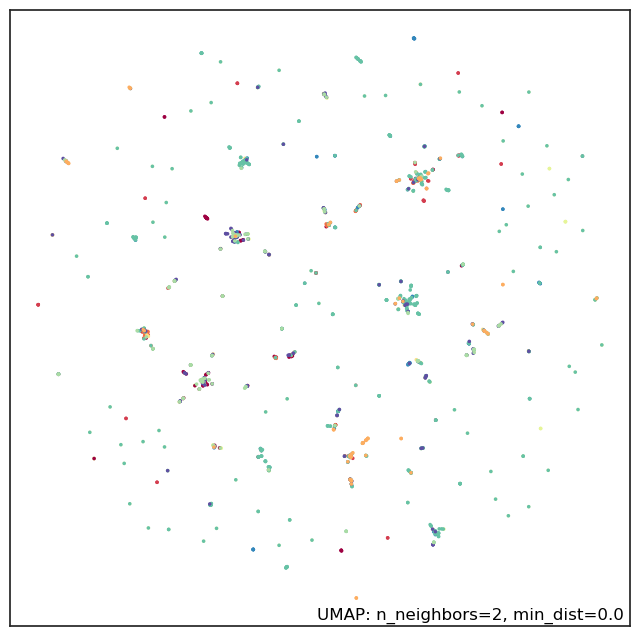

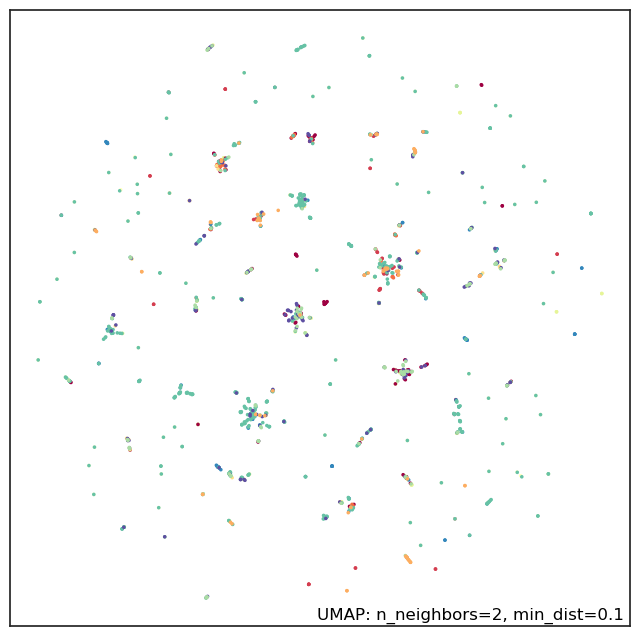

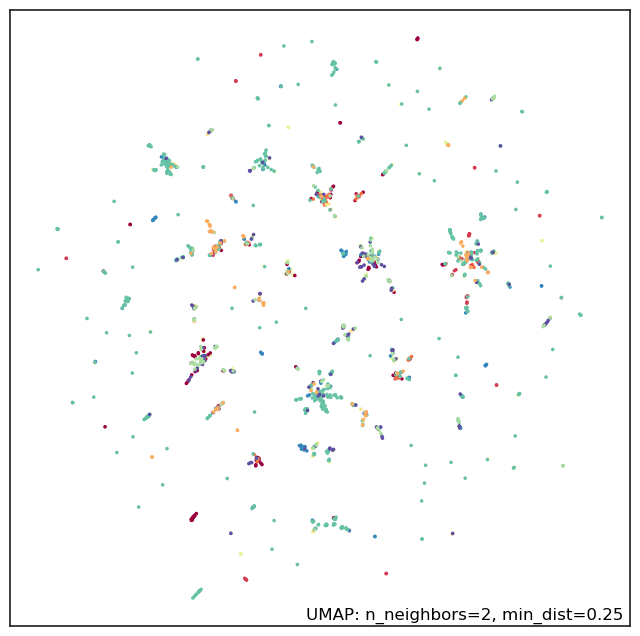

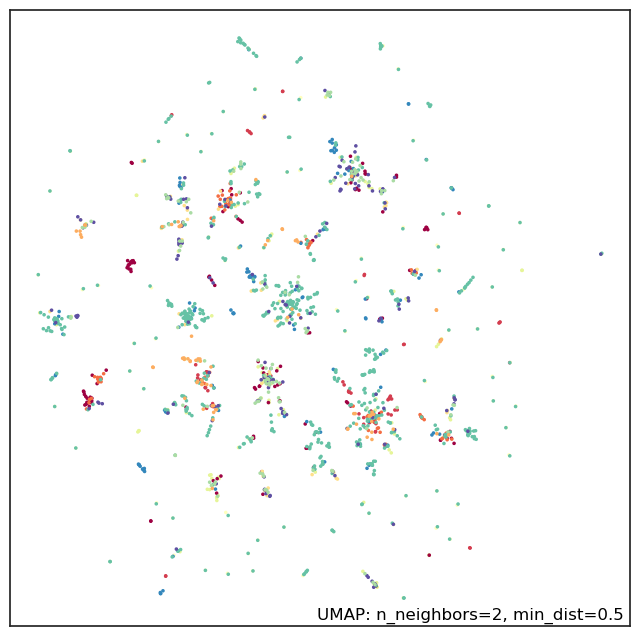

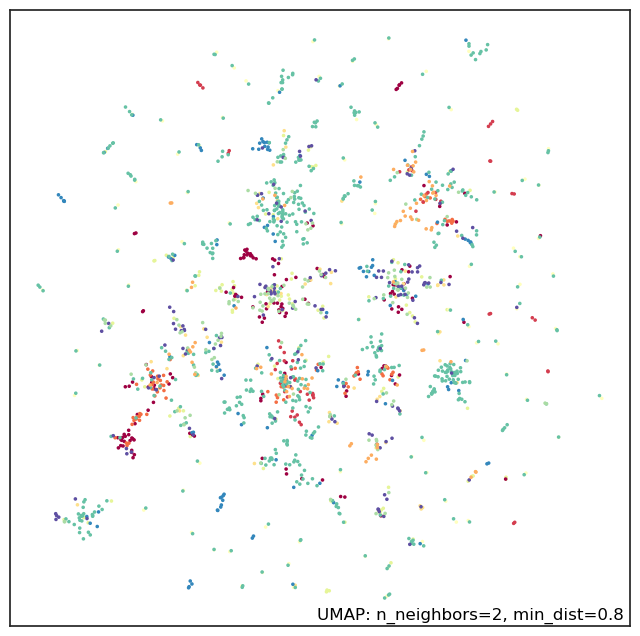

...

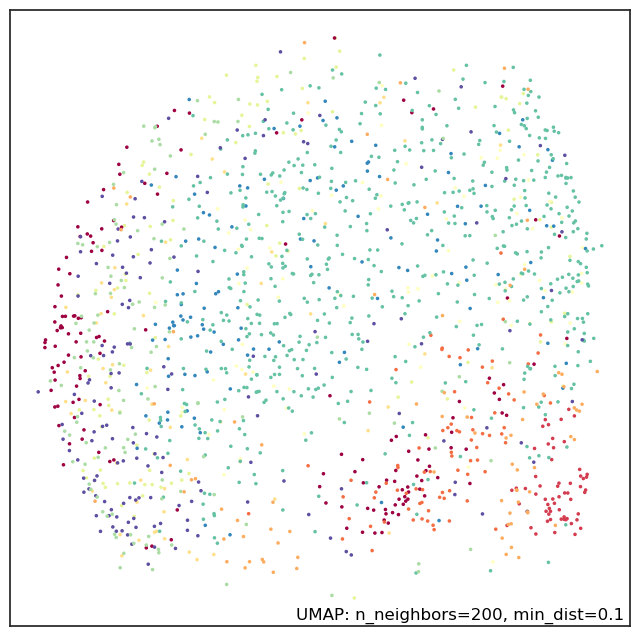

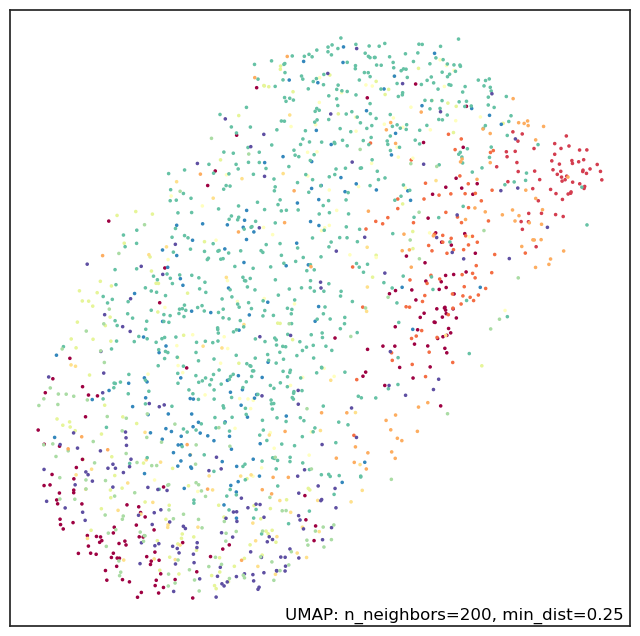

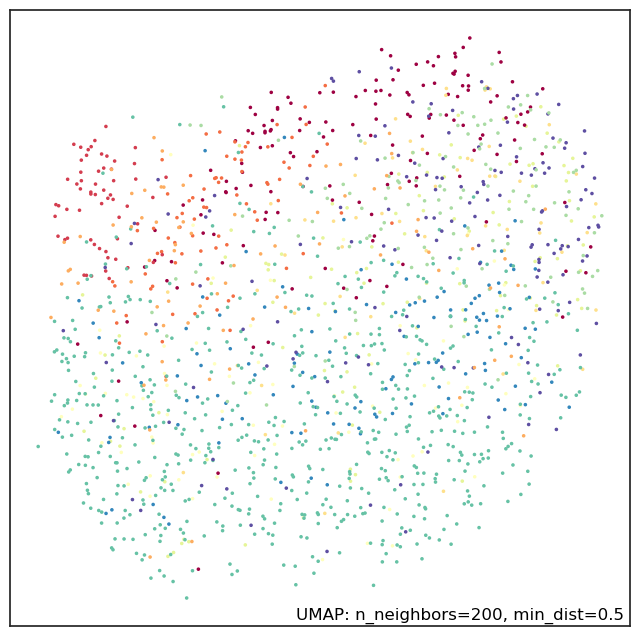

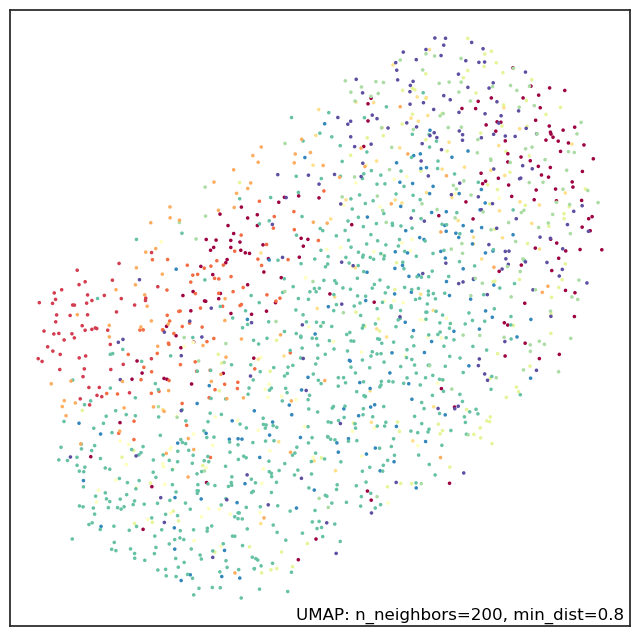

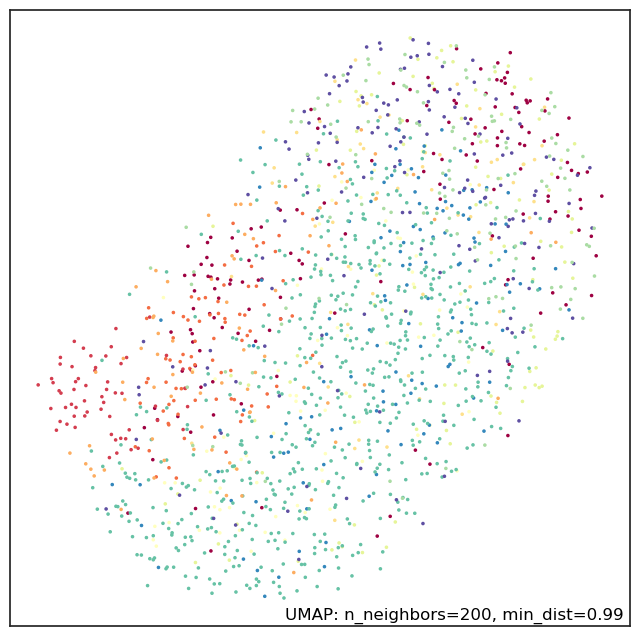

In [11]:
# try out a combination of values for n_neighbors and min_dist
for i in (2,5,10,20,50,100,200):
    for j in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
        create_umap_embedding(marker_array, draw=True, labels=marker_T.study_name.values, n_neighbors=i, min_dist=j)
        plt.legend().remove()

In [ ]:
# # pick most promising sets of parameters and compare disease with study_name
# disease_labels = merged_T.disease.values
# cohort_labels = merged_T.study_name.values

# create_umap_embedding(input_array, draw=True, labels=[disease_labels, cohort_labels], n_neighbors=10, min_dist=0.25)
# plt.legend().remove()

In [ ]:
# # compare different metadata labels
# labels = list()
# exclude = ['sample_name', 'age']
# for col in metadata_cols:
#     if not col in exclude:
#         labels.append(merged_T[col].values)

# create_umap_embedding(input_array, draw=True, labels=labels, n_neighbors=10, min_dist=0.1)

## Final Embeddings

### Input

#### Abundance

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


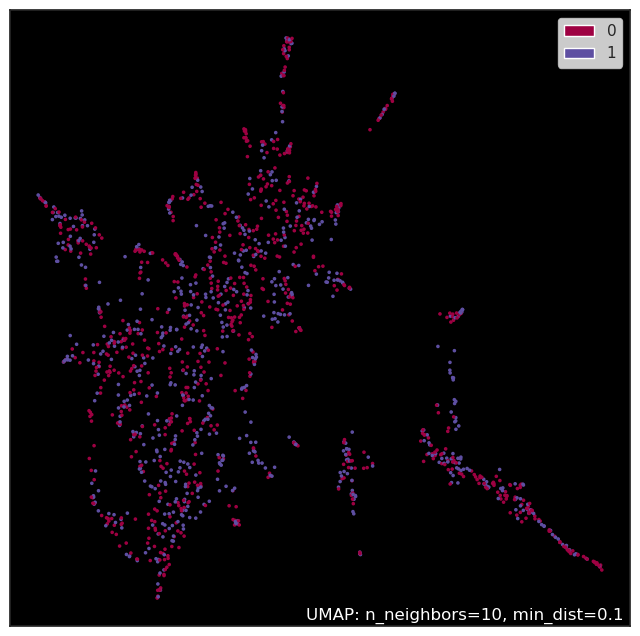

In [23]:
# show two plots next to each other
# UMAP with best parameters based on manual search, labeled by disease, based on abundance profiles
params={
    'n_neighbors':10,
    'min_dist':0.1
}
create_umap_embedding(abundance_array, draw=True, labels=abundance_T['gt'].values, **params)
# plt.legend().remove()

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


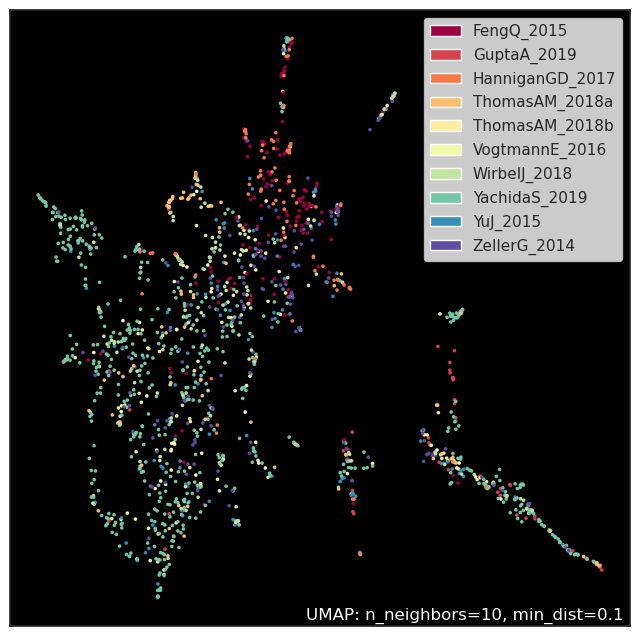

In [24]:
# show two plots next to each other
# UMAP with best parameters based on manual search, labeled by study_name, based on abundance
params={
    'n_neighbors':10,
    'min_dist':0.1
}
create_umap_embedding(abundance_array, draw=True, labels=abundance_T.study_name.values, **params)
# plt.legend().remove()

#### Marker

In [8]:
# UMAP with best parameters based on manual search, labeled by disease, based on gene markers
params={
    'n_neighbors':20,
    'min_dist':0.0
}
reducer, embedding = create_umap_embedding(marker_array, draw=False, labels=marker_T['gt'].values, **params)
# plt.legend().remove()

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [13]:
labels = marker_T['gt'].tolist()
labels = ["Diseased" if i == 1 else "Healthy" for i in labels]

umap_df = pd.DataFrame(
    {
        'umap_1': embedding[:, 0],
        'umap_2': embedding[:, 1],
        'Groundtruth': labels,
        'Cohort': marker_T['study_name'].tolist(),
        'DNA Extraction Kit': marker_T['DNA_extraction_kit'].tolist(),
        'Sequencing Platform': marker_T['sequencing_platform'].tolist(),
    }
)

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

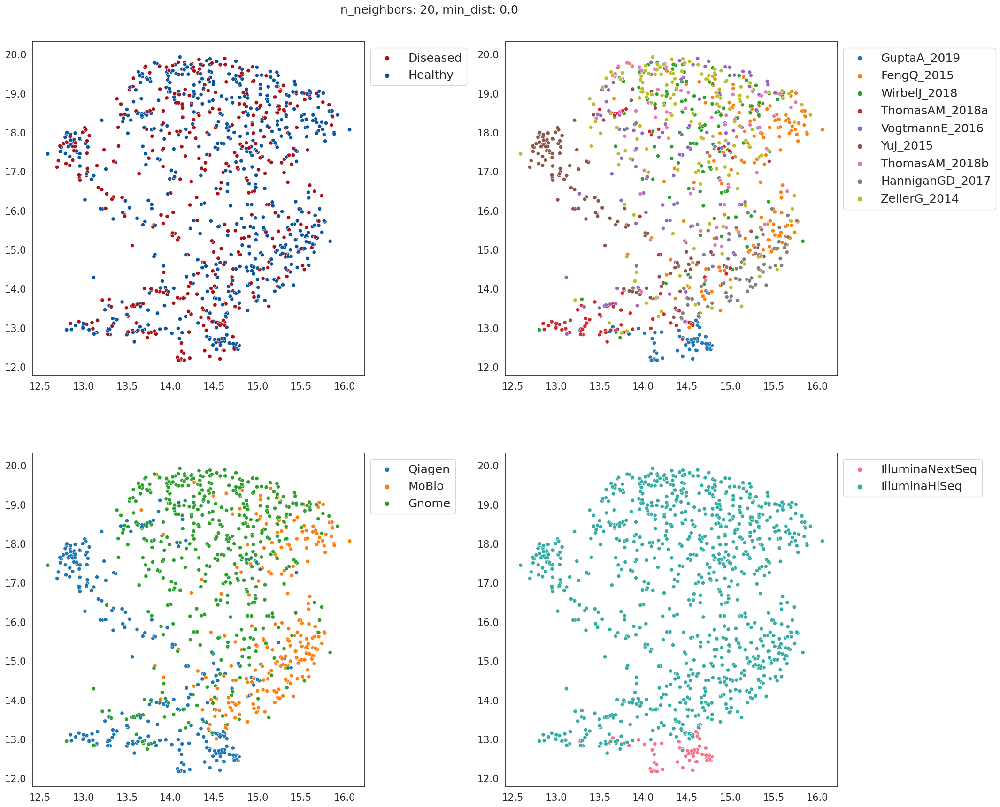

In [72]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2, figsize=(18, 18))
fig.suptitle(f"n_neighbors: {params['n_neighbors']}, min_dist: {params['min_dist']}", fontsize=18)
plt.subplots_adjust(left=0.1, bottom=0.1, right=0.9, 
                    top=0.95, wspace=0.6,hspace=0.4)

fig.tight_layout(h_pad=2, w_pad=15)

# plot 1 -  Groundtruth
gt_palette = [sns.color_palette('Reds')[-1], sns.color_palette('Blues')[-1]]
plot_1 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='Groundtruth',
    ax=ax1,
    palette=gt_palette
)

# plot 2 -  Cohort
plot_2 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='Cohort',
    ax=ax2,
    palette=sns.color_palette('tab10', desat=1)
)

# plot 2 -  Cohort
plot_3 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='DNA Extraction Kit',
    ax=ax3,
    palette=sns.color_palette('tab10', n_colors=3, desat=1)
)

# plot 2 -  Cohort
plot_4 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='Sequencing Platform',
    ax=ax4,
    palette=sns.color_palette('husl', n_colors=2, desat=1)
)

plots = [plot_1, plot_2, plot_3, plot_4]

for plot in plots:
    plot.legend(fontsize=18, bbox_to_anchor=(1,1))
    # sns.move_legend(plot, "upper left", bbox_to_anchor=(1, 1))
    plot.set(xlabel=None)
    plot.set(ylabel=None)
    plot.set_yticklabels(plot.get_yticks(), size = 15)
    plot.set_xticklabels(plot.get_xticks(), size = 15)
    plot.set_aspect(0.45)

#### Other parameter pairs that looked good during HPO:

n_neighbors: 5
min_dist: 0.0

n_neighbors: 10
min_dist: 0.1

n_neighbors: 50
min_dist: 0.0

### Latent Space New

In [2]:
# import latent space parameters
latent_parameters = pd.read_csv("/home/nle-mvonstetten/microbiome-conditional/notebooks/datav3/results/in_cohort_results/in_c/latent_space_parameters/latent_parameters_old_hp.csv")

drop_cols = ['gt', 'study_name', 'DNA_extraction_kit', 'sequencing_platform', 'set']
latent_array = latent_parameters.drop(columns=drop_cols).values

#### HPO

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-p

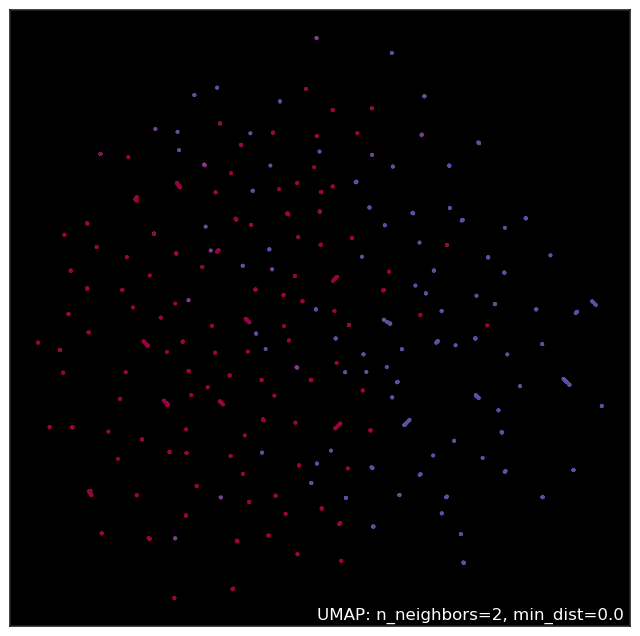

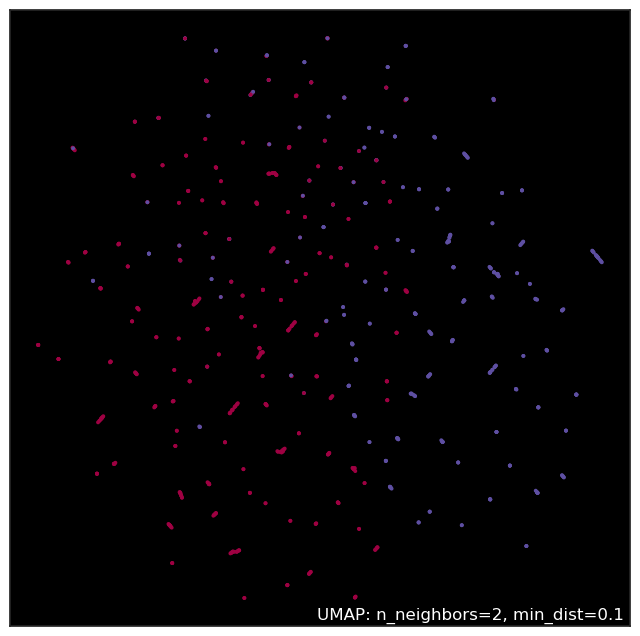

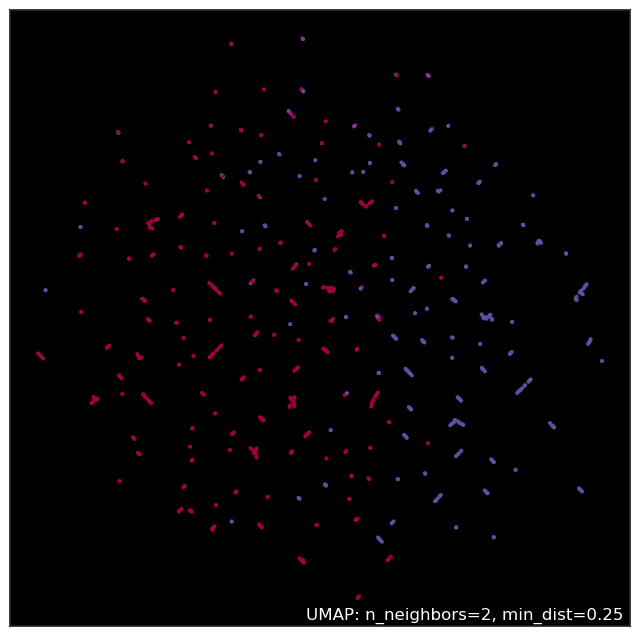

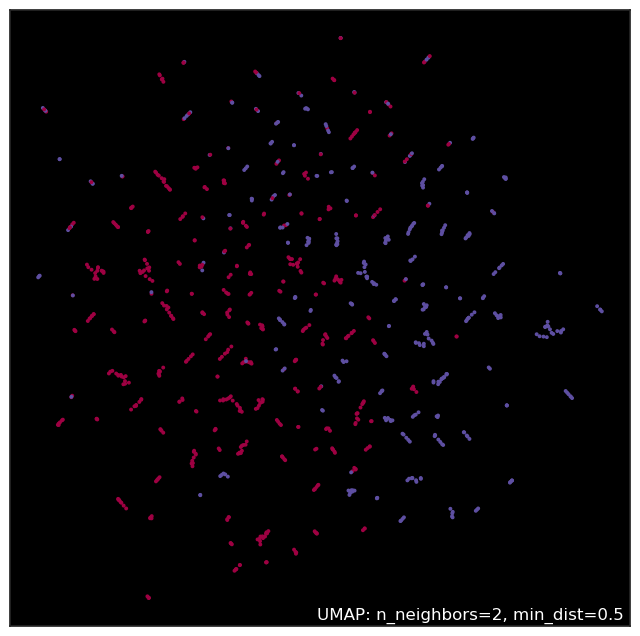

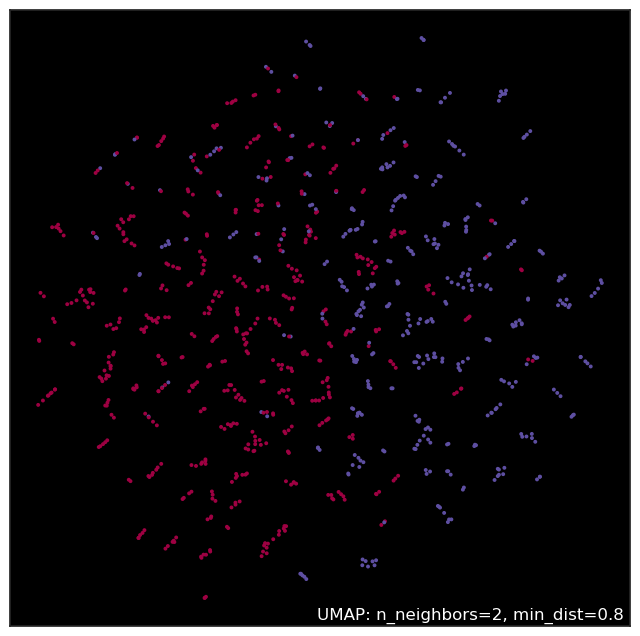

...

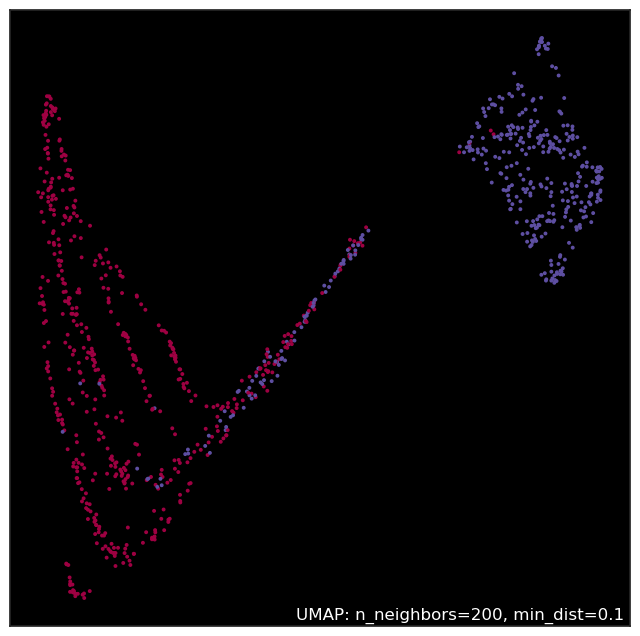

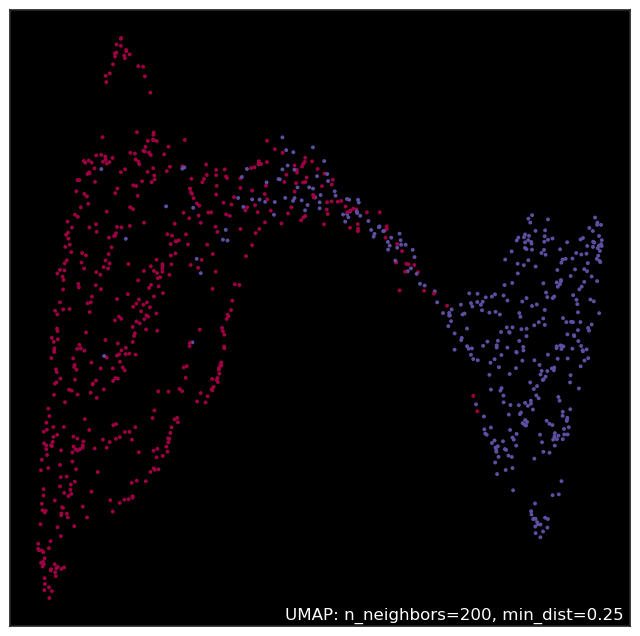

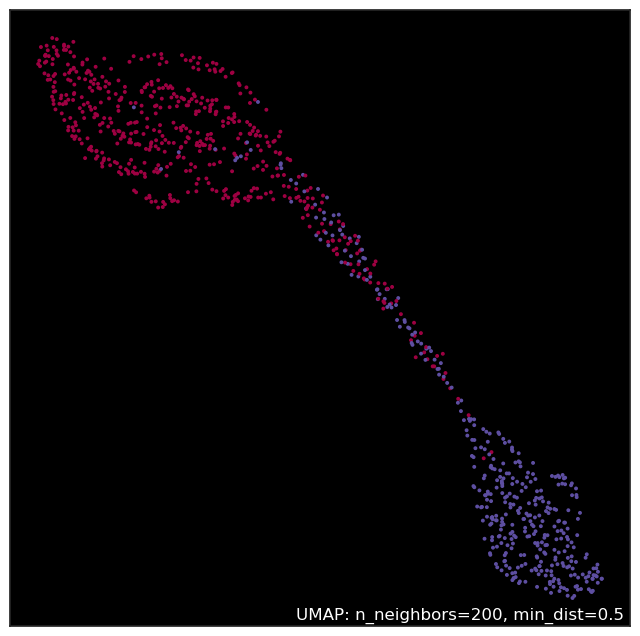

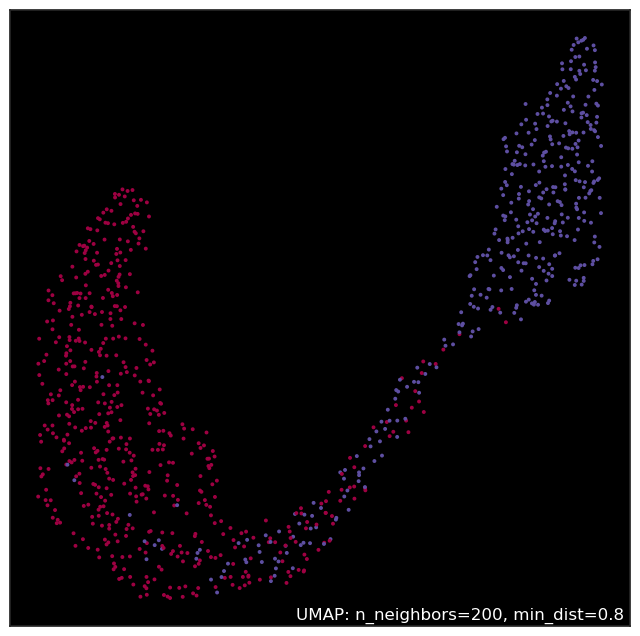

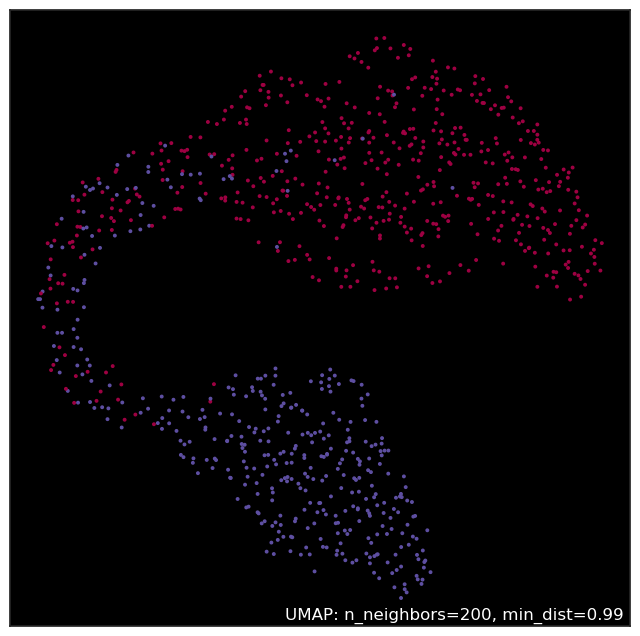

In [9]:
# try out a combination of values for n_neighbors and min_dist
for i in (2,5,10,20,50,100,200):
    for j in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
        create_umap_embedding(latent_array, draw=True, labels=latent_parameters['gt'].values,  n_neighbors=i, min_dist=j)
        plt.legend().remove()

#### Final Embedding

In [34]:
params={
    'n_neighbors':20,
    'min_dist':0.99
}
reducer, embedding = create_umap_embedding(latent_array, draw=False, labels=None, **params)

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [35]:
labels = latent_parameters['gt'].tolist()
labels = ["Diseased" if i == 1 else "Healthy" for i in labels]

umap_df = pd.DataFrame(
    {
        'umap_1': embedding[:, 0],
        'umap_2': embedding[:, 1],
        'Groundtruth': labels,
        'Cohort': latent_parameters['study_name'].tolist(),
        'DNA Extraction Kit': latent_parameters['DNA_extraction_kit'].tolist(),
        'Sequencing Platform': latent_parameters['sequencing_platform'].tolist(),
        'Set': latent_parameters['set'].tolist()
    }
)

In [53]:
# make sure that hue is using the same order as the input embeddings
cohort_order = marker_T['study_name'].unique().tolist()
kit_order = marker_T['DNA_extraction_kit'].unique().tolist()
platform_order = marker_T['sequencing_platform'].unique().tolist()

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

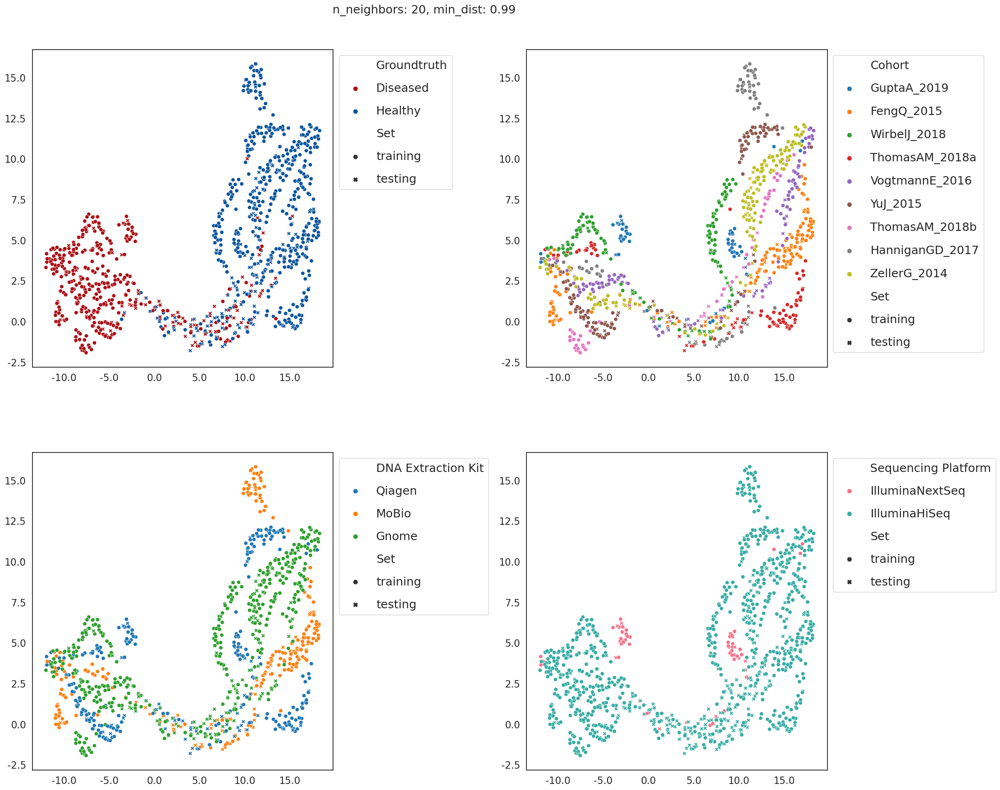

In [70]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2, figsize=(18, 18))
fig.suptitle(f"n_neighbors: {params['n_neighbors']}, min_dist: {params['min_dist']}", fontsize=18)
plt.subplots_adjust(left=0.1, bottom=0.1, right=0.9, 
                    top=0.95, wspace=0.6,hspace=0.4)

fig.tight_layout(h_pad=1, w_pad=22)

# plot 1 -  Groundtruth
gt_palette = [sns.color_palette('Reds')[-1], sns.color_palette('Blues')[-1]]
plot_1 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='Groundtruth',
    ax=ax1,
    palette=gt_palette,
    style='Set'
)

# plot 2 -  Cohort
plot_2 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='Cohort',
    ax=ax2,
    palette=sns.color_palette('tab10', desat=1),
    style='Set',
    hue_order=cohort_order
)

# plot 3 -  DNA extraction kit
plot_3 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='DNA Extraction Kit',
    ax=ax3,
    palette=sns.color_palette('tab10', n_colors=3, desat=1),
    style='Set',
    hue_order=kit_order
)

# plot 4 -  sequencing platform
plot_4 = sns.scatterplot(
    data=umap_df,
    x='umap_1',
    y='umap_2',
    hue='Sequencing Platform',
    ax=ax4,
    palette=sns.color_palette('husl', n_colors=2, desat=1),
    style='Set',
    hue_order=platform_order
)

plots = [plot_1, plot_2, plot_3, plot_4]

for plot in plots:
    plot.legend(fontsize=18, bbox_to_anchor=(1,1), labelspacing=1)
    # sns.move_legend(plot, "upper left", bbox_to_anchor=(1, 1))
    plot.set(xlabel=None)
    plot.set(ylabel=None)
    plot.set_yticklabels(plot.get_yticks(), size = 15)
    plot.set_xticklabels(plot.get_xticks(), size = 15)
    plot.set_aspect(1.8)

### Latent Space

#### Functions

In [8]:
# function to add metadata to the latent space embeddings
def add_original_id_to_latent_space(latent_space,
                                    cohort_col="cohort_name", 
                                    sample_col="patient_id", 
                                    id_col="original_id"):
    """
    Function to add original index to rows in the latent space df.
    With the purpose of mapping to metadata.
    :param latent_space: df with latent space means of samples
    :param cohort_col: column with names of cohorts that samples belong to
    :param sample_col: column with patient_ids from fmd (basically range(0, len(dataset)))
    :param id_col: column with id that is then used to map to metadata df of a specific cohort
    """
    for cohort in latent_space[cohort_col].unique():
        idx = latent_space.loc[latent_space[cohort_col] == cohort, sample_col].index
        original_ids = list(range(len(idx)))
        latent_space.loc[idx, id_col] = original_ids

    latent_space['original_id'] = latent_space['original_id'].astype(int)

def add_metadata_to_latent_space(latent_space, metadata, cols_to_add, id_col="original_id", cohort_col="cohort_name"):
    """
    Function to add metadata to df with latent space means
    :param latent_space: df with latent space means of samples
    :param metadata: df with metadata to be mapped to latent_space df
    :param cols_to_add: list of columns to be added from metadata
    :param id_col: column name of id column to be used for the mapping
    :param cohort_col: column name to identify individual cohorts
    """
    transposed_metadata = dict()
    for study_name, dataset in metadata.items():
        dataset.drop(columns=['fieldname'], inplace=True)
        data_T = dataset.T
        data_T.reset_index(drop=False, inplace=True)
        transposed_metadata[study_name] = data_T
    
    if not id_col in latent_space.columns:
        add_original_id_to_latent_space(latent_space)

    for cohort, dataset in transposed_metadata.items():
        cohort = f"CRC_{cohort}"
        dataset_idx = latent_space.loc[latent_space[cohort_col] == cohort, id_col].tolist()
        latent_idx = latent_space.loc[latent_space[cohort_col] == cohort].index

        for col in cols_to_add:
            if not col in dataset.columns:
                latent_space.loc[latent_idx, col] = "nd"
            else:
                latent_space.loc[latent_idx, col] = dataset.loc[dataset_idx, col].tolist()

def create_per_cohort_embedding_latent(cohort_name, latent_space_df, drop_cols, params, labels=None):
    """
    Function to create a UMAP for latent space means of a specific cohort.
    :param cohort_name: Name of the cohort to be visualized
    :param latent_space_df: df containing the latent space means from CMVIB
    :param drop_cols: list with column names to be dropped when creating the input array for UMAP
    :param params: dict with parameters used for UMAP (n_neighbors, min_dist, ...)
    :param labels: numpy array of column to be used for labeling
    """
    latent_raw = latent_space_df[latent_space_df['cohort_name'] == cohort_name]
    input_array = latent_raw.drop(columns=drop_cols).values

    create_umap_embedding(input_array, draw=True, labels=latent_raw[labels].values, **params)
    plt.legend().remove()
    plt.title(cohort_name)

def create_per_cohort_embedding_input(cohort_name, params, metadata_cols=metadata_cols, labels=None):
    """
    Function to create a UMAP for abundance input of a specific cohort
    :param cohort_name: Name of the cohort to be visualized
    :param params: dict with parameters used for UMAP (n_neighbors, min_dist, ...)
    :param metadata_cols: columns to be kept in the abundnace_T dataframe
    :param labels: numpy array of column to be used for labeling
    """
    cohort_dict = {cohort_name:abundance_data[cohort_name].copy()}
    abundance_T, abundance_array = prepare_data(cohort_dict, metadata_cols=metadata_cols)

    for label, gt in label_dict.items():
        abundance_T.loc[abundance_T['disease'] == label, 'gt'] = gt

    create_umap_embedding(abundance_array, draw=True, labels=abundance_T[labels].values, **params)
    plt.legend().remove()
    plt.title(cohort_name)

#### UMAP for Latent Space Means from CMVIB Test results

In [14]:
# import csv file with latent space means for all samples in the set
latent_space_test_samples = pd.read_csv("./results/latent_space_test_samples.csv", sep=",")

# subset to only cohorts that have auroc of at least 0.8
cohorts_to_keep = [
    'CRC_FengQ_2015',
    'CRC_GuptaA_2019',
    'CRC_WirbelJ_2018',
    'CRC_YuJ_2015',
    'CRC_ZellerG_2014'
]

latent_space_test_samples = latent_space_test_samples[latent_space_test_samples['cohort'].isin(cohorts_to_keep)]

# import metadata
metadata = get_data(abundance_location, nrows=209, data_modality='abundance', sep=",")

# add desired metadata to the latent space dataframe
cols_to_add = [
    'disease',
    'ajcc',
    'country'
]

add_metadata_to_latent_space(latent_space_test_samples, metadata, cols_to_add, cohort_col="cohort")

/tmp/ipykernel_1385392/4083901065.py:49: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['CRC', 'healthy', 'CRC', 'healthy', 'CRC', 'healthy', 'healthy', 'healthy', 'CRC', 'healthy', 'CRC', 'healthy']' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  latent_space.loc[latent_idx, col] = dataset.loc[dataset_idx, col].tolist()
/tmp/ipykernel_1385392/4083901065.py:49: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['iii', 'nd', 'i', 'nd', 'iii', 'nd', 'nd', 'nd', 'iii', 'nd', 'iii', 'nd']' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  latent_space.loc[latent_idx, col] = dataset.loc[dataset_idx, col].tolist()
/tmp/ipykernel_1385392/4083901065.py:49: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '

In [16]:
# Metadata columns to exclude when creating the input arrays
metadata_cols = [
    'patient_id',
    'disease_status',
    'cohort',
    'original_id',
    'disease',
    'ajcc',
    'country'
]

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


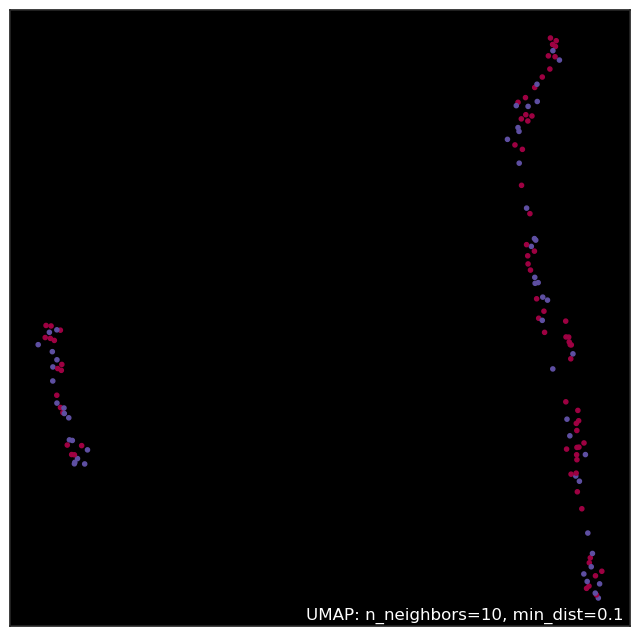

In [20]:
# UMAP of latent space means from CMVIB test results (all cohorts)
input_array = latent_space_test_samples.drop(columns=metadata_cols).values

params={
    'n_neighbors':10,
    'min_dist':0.1
}
create_umap_embedding(input_array, draw=True, labels=latent_space_test_samples['disease_status'].values, **params)
plt.legend().remove()

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


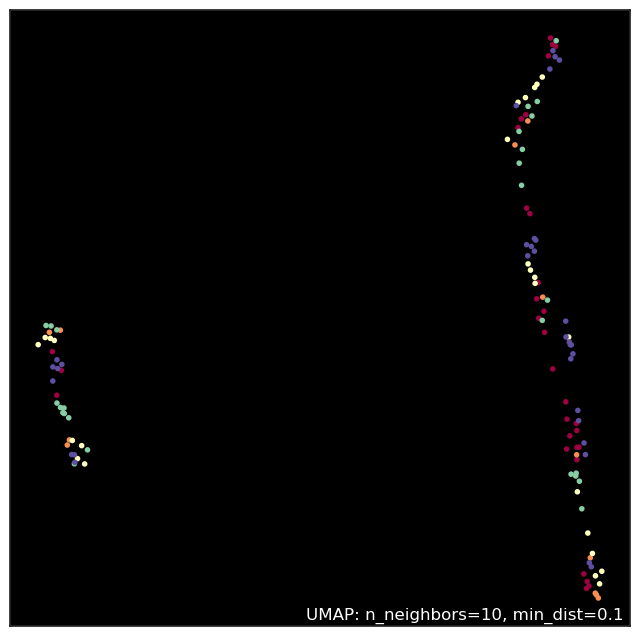

In [21]:
# UMAP of latent space means from CMVIB test results (Good performing cohorts only)
input_array = latent_space_test_samples.drop(columns=metadata_cols).values

params={
    'n_neighbors':10,
    'min_dist':0.1
}
create_umap_embedding(input_array, draw=True, labels=latent_space_test_samples.cohort.values, **params)
plt.legend().remove()

#### HPO for the test sample UMAPs

In [ ]:
# try out a combination of values for n_neighbors and min_dist
# labeled by disease
for i in (2,5,10,20,50,100,200):
    for j in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
        create_umap_embedding(input_array, draw=True, labels=latent_space_test_samples['disease_status'].values,  n_neighbors=i, min_dist=j)
        plt.legend().remove()

In [ ]:
# try out a combination of values for n_neighbors and min_dist
# labeled by cohort
for i in (2,5,10,20,50,100,200):
    for j in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
        create_umap_embedding(input_array, draw=True, labels=latent_space_test_samples['cohort'].values,  n_neighbors=i, min_dist=j)
        plt.legend().remove()

#### UMAP for Latent Space and Input (Abundance) (Cohort-wise)

In [33]:
# Import latent space means for all samples in the entire data
latent_space_all_samples = pd.read_csv('./results/latent_space_all_samples.csv', sep=",")

In [ ]:
# iterate over all cohorts in the data and create a UMAP based on the latent space means
metadata_cols = [
    "patient_id",
    "gt",
    "cohort",
    "cohort_name"
]

for cohort_name in latent_space_all_samples.cohort_name.unique():

    create_per_cohort_embedding_latent(
        cohort_name, 
        latent_space_all_samples, 
        metadata_cols, 
        params,
        labels="gt"
    )

In [ ]:
params={
    'n_neighbors':10,
    'min_dist':0.1
}

# right now the global variable `metadata_cols` used during import is used here as well
# might cause problems in the future

for cohort_name in abundance_data.keys():
    if cohort_name == "ThomasAM_2019_c":
        continue

    create_per_cohort_embedding_input(cohort_name, params, metadata_cols=metadata_cols, labels="gt")

#### UMAP for Latent Space (All Samples together)

In [21]:
# import csv file with latent space means for all samples in the set
latent_space_all_samples = pd.read_csv("./results/latent_space_all_samples.csv", sep=",")

# import metadata
metadata = get_data(abundance_location, nrows=209, data_modality='abundance', sep=",")

# add desired metadata to the latent space dataframe
cols_to_add = [
    'disease',
    'ajcc',
    'country'
]

add_metadata_to_latent_space(latent_space_all_samples, metadata, cols_to_add)

/tmp/ipykernel_1266278/4083901065.py:49: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'healthy', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC', 'CRC']' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  latent_space.loc[latent_idx, col] = dataset.loc[dataset_idx, col].tolist()
/tmp/ipykernel_1266278/4083901065.py:49: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a futur

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 1.0, 'All Samples')

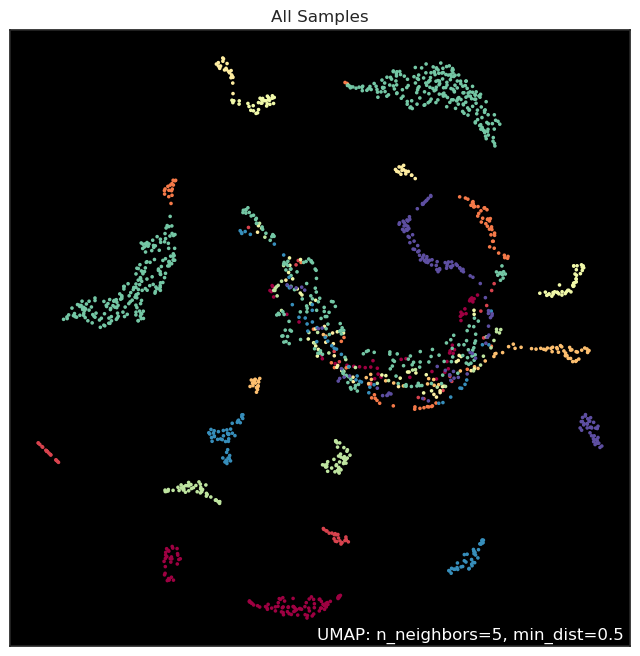

In [26]:
cols_to_drop = [
    'patient_id',
    'gt',
    'cohort',
    'cohort_name',
    'disease',
    'original_id',
    'ajcc',
    'country'
]

params={
    'n_neighbors':5,
    'min_dist':0.5
}

input_array = latent_space_all_samples.drop(columns=cols_to_drop).values

create_umap_embedding(input_array, draw=True, labels=latent_space_all_samples['cohort_name'].values, **params)
plt.legend().remove()
plt.title("All Samples")

In [95]:
# group the disease labels
# transform the disease column so that it only contains simplified labels
latent_space_all_samples.loc[latent_space_all_samples['disease'].str.contains('CRC'), 'disease_reduced'] = "CRC"
latent_space_all_samples.loc[latent_space_all_samples['disease'] == "healthy", 'disease_reduced'] = "healthy"
latent_space_all_samples.loc[latent_space_all_samples['disease'].str.contains('adenoma'), 'disease_reduced'] = "adenoma"
latent_space_all_samples.loc[(latent_space_all_samples['disease'] != 'CRC') & 
        (latent_space_all_samples['disease'] != 'adenoma') & 
        (latent_space_all_samples['disease'] != 'healthy'), 'disease_reduced'] = "other diseases"

/tmp/ipykernel_2565293/2992214497.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'CRC' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  latent_space_all_samples.loc[latent_space_all_samples['disease'].str.contains('CRC'), 'disease_reduced'] = "CRC"


### Short HPO for the latent space means of all samples

/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data/lib/python3.11/site-p

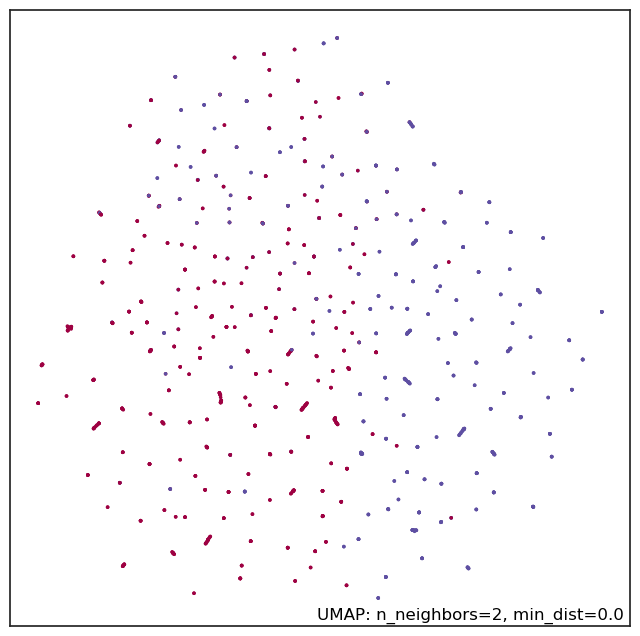

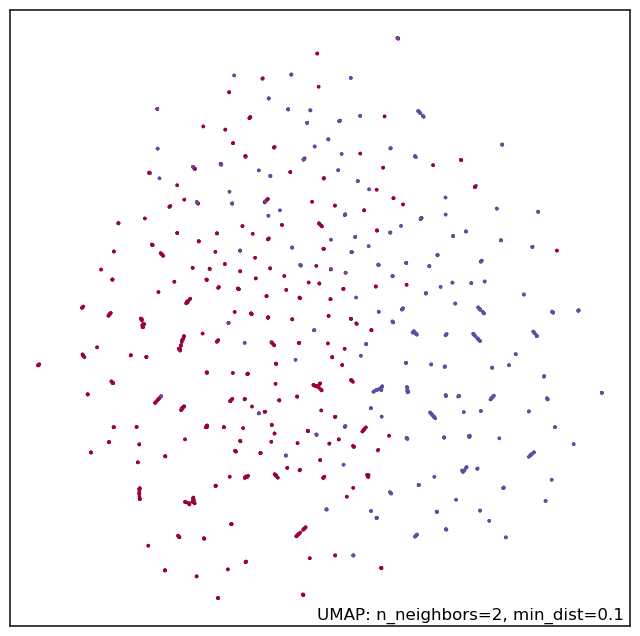

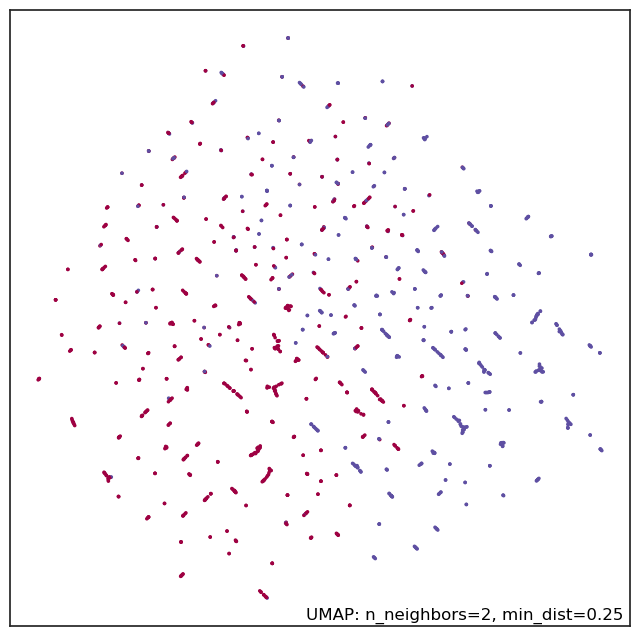

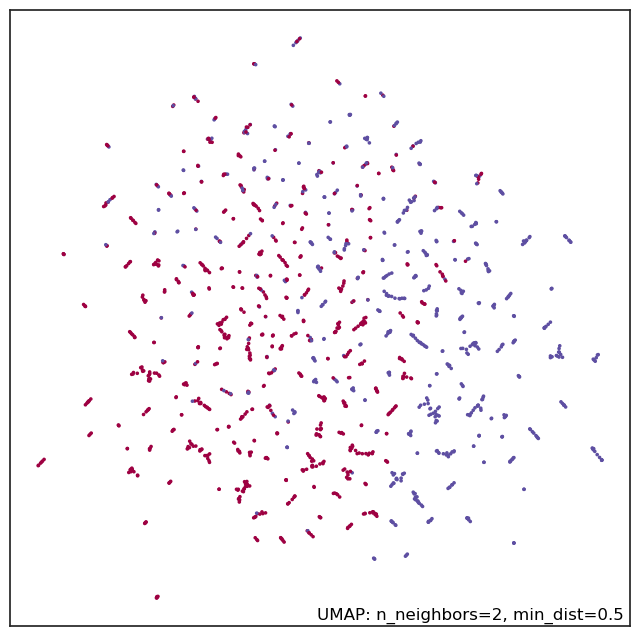

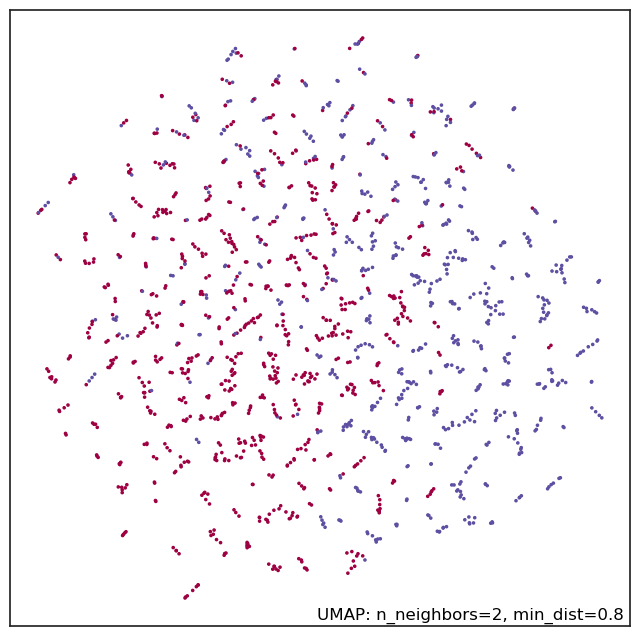

...

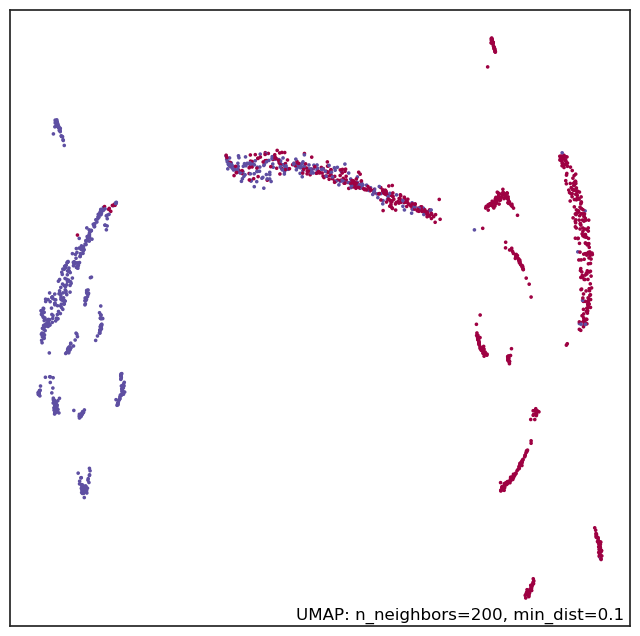

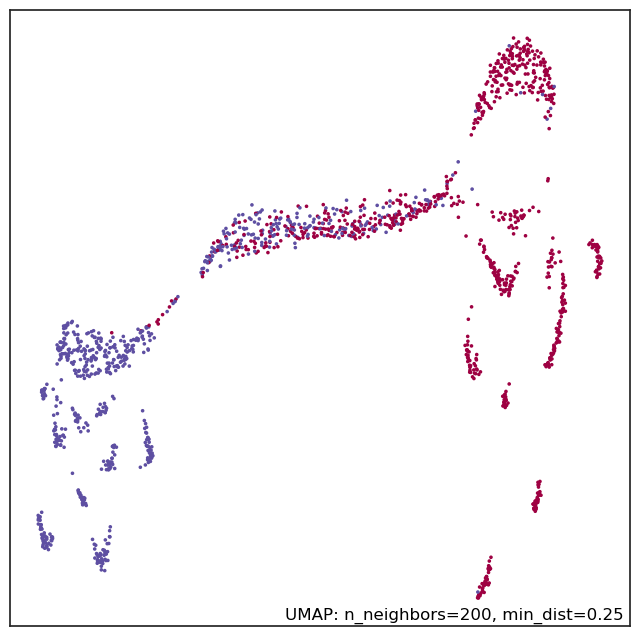

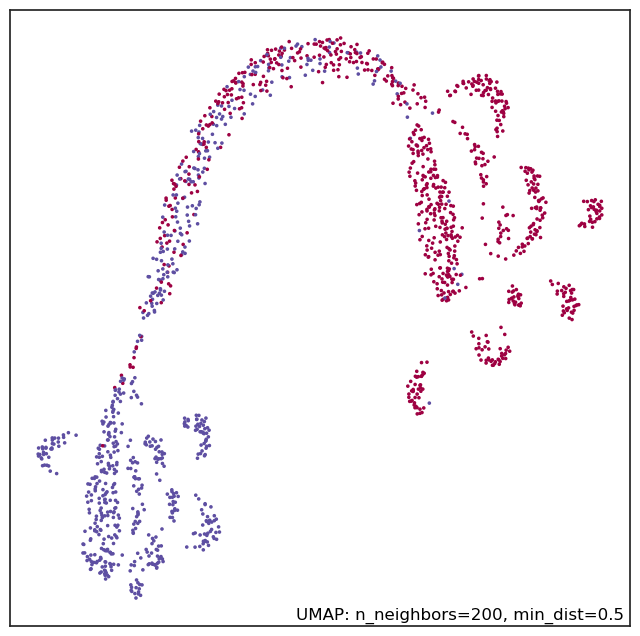

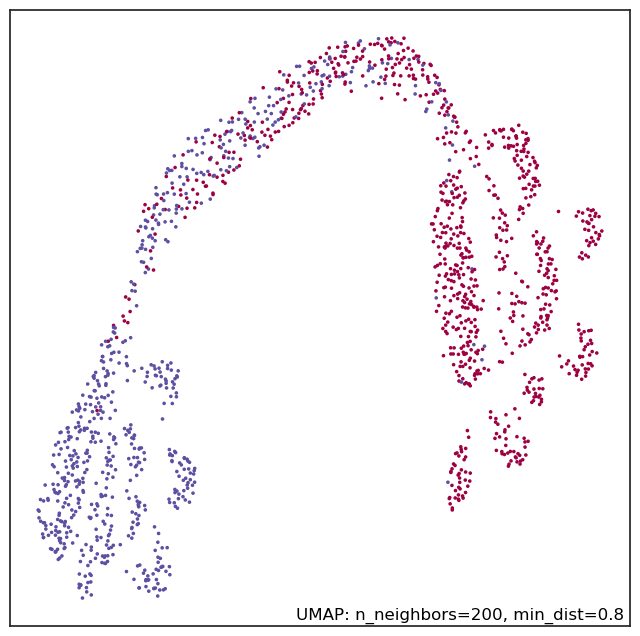

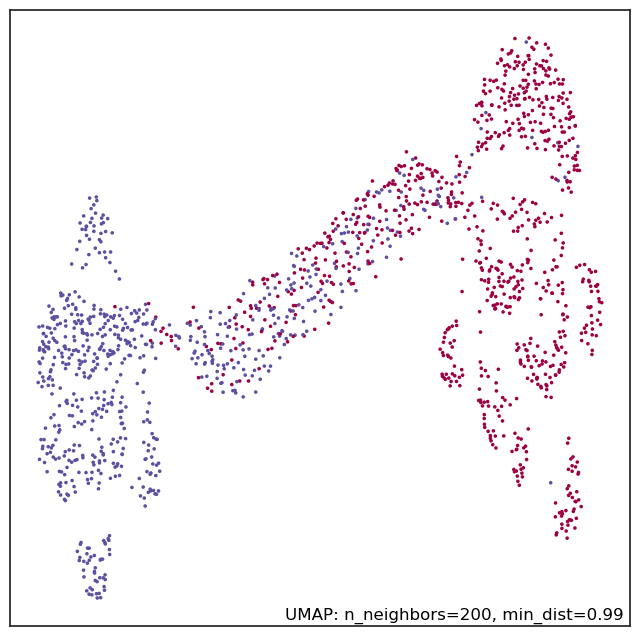

In [16]:
# try out a combination of values for n_neighbors and min_dist
for i in (2,5,10,20,50,100,200):
    for j in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
        create_umap_embedding(input_array, draw=True, labels=latent_space_all_samples['gt'].values,  n_neighbors=i, min_dist=j)
        plt.legend().remove()

# t-SNE

## Functions

In [50]:
def create_tsne_embedding(input_array, draw=False, labels=None, **kwargs):
    hp = {
        "n_components":2,
        "perplexity":50,
        "n_iter":1000,
        "random_state":42
    }

    for keyword, arg in kwargs.items():
        if keyword in hp.keys():
            hp[keyword] = arg

    reducer = TSNE(
        n_components=hp.get("n_components"),
        perplexity=hp.get("perplexity"),
        n_iter=hp.get("n_iter"),
        random_state=hp.get("random_state")
    )

    embedding = reducer.fit_transform(input_array)

    if draw:
        tsne_df = pd.DataFrame({
            'tsne_1':embedding[:,0],
            'tsne_2':embedding[:,1],
            'labels': labels
        })

        n_labels = len(tsne_df['labels'].unique())
        palette = sns.color_palette(cc.glasbey, n_colors=n_labels)
    
        sns.scatterplot(
            x='tsne_1', 
            y='tsne_2', 
            hue='labels', 
            data=tsne_df,
            size=50,
            palette=palette
            )

        perplexity = hp.get("perplexity")
        iterations = hp.get("n_iter")
        plt.title(f"Perplexity: {perplexity}, Iterations: {iterations}")
        plt.show()

## HPO

/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldc

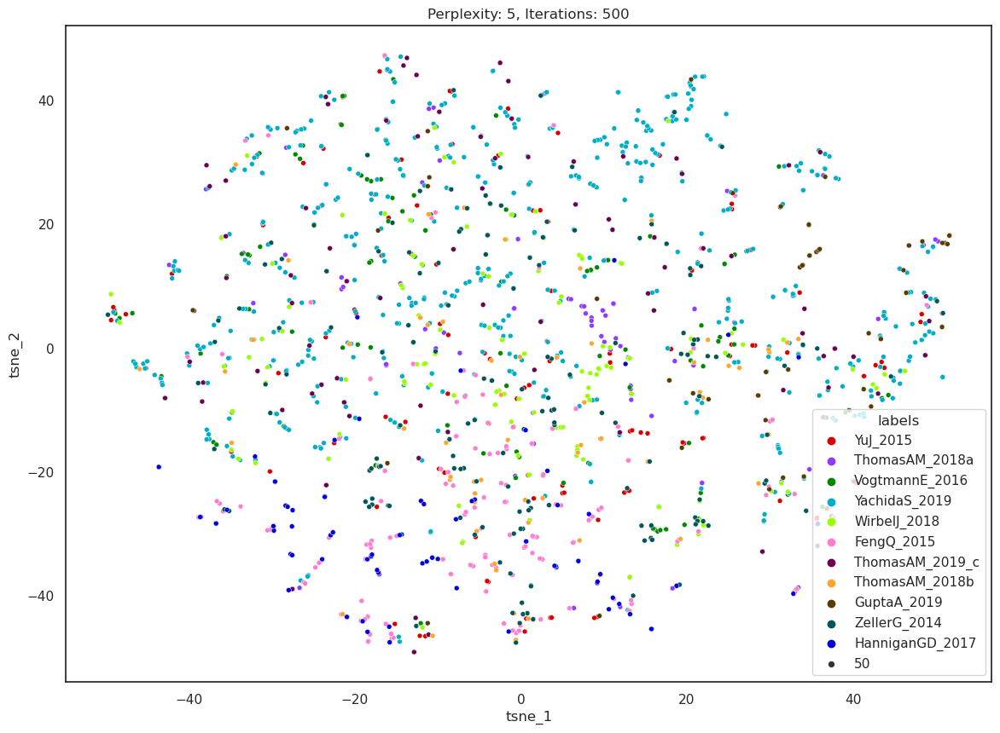

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

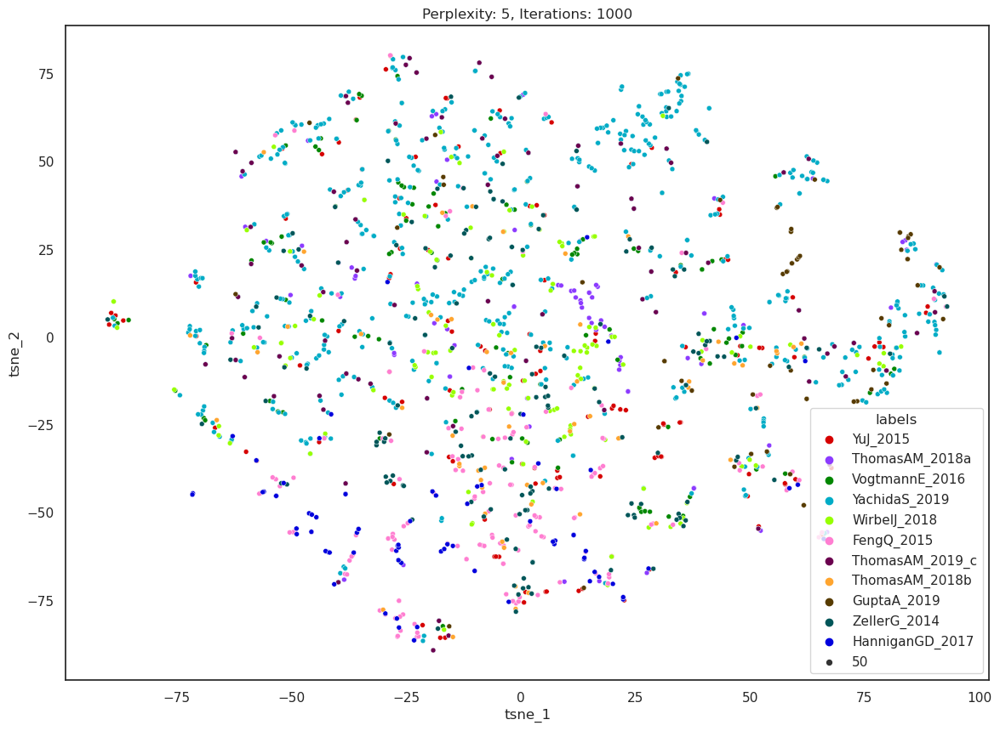

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

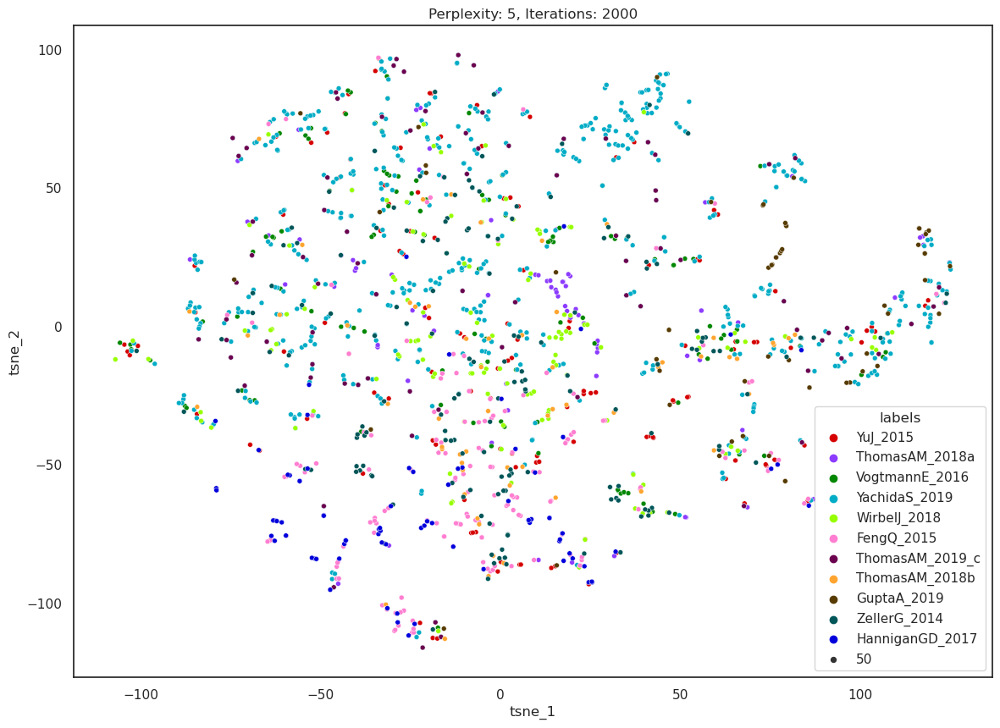

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

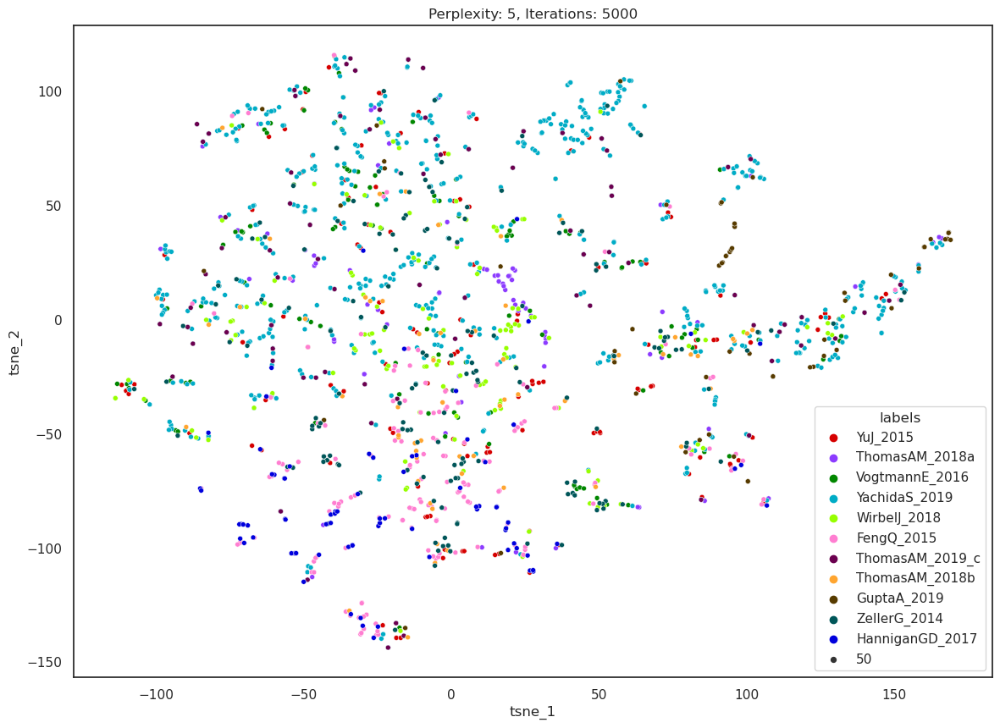

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

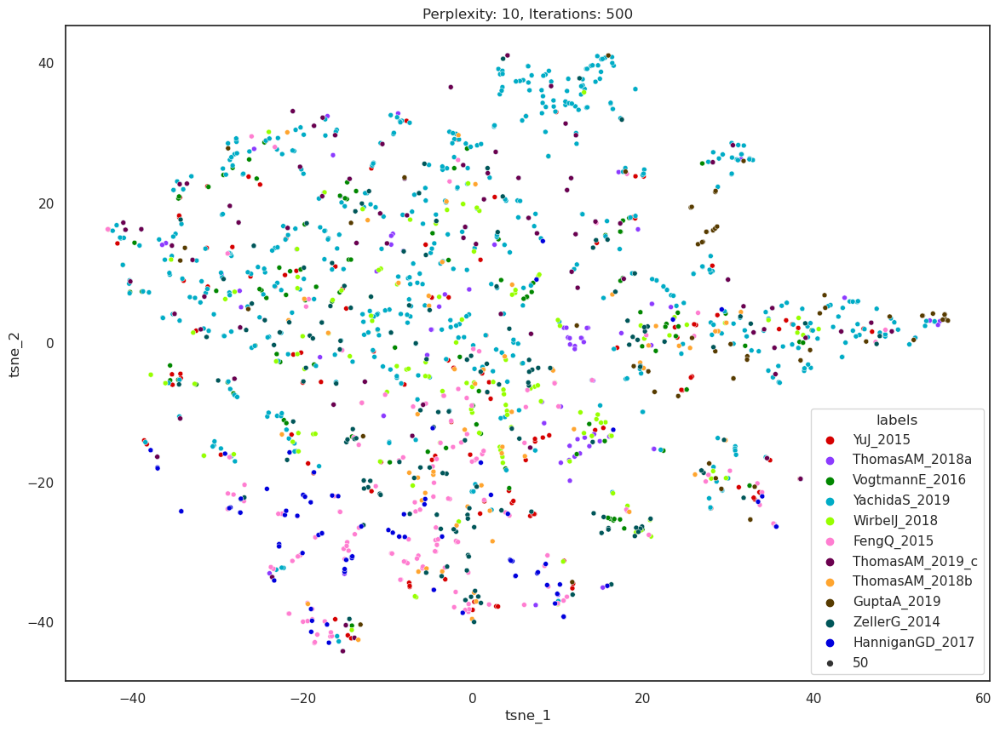

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

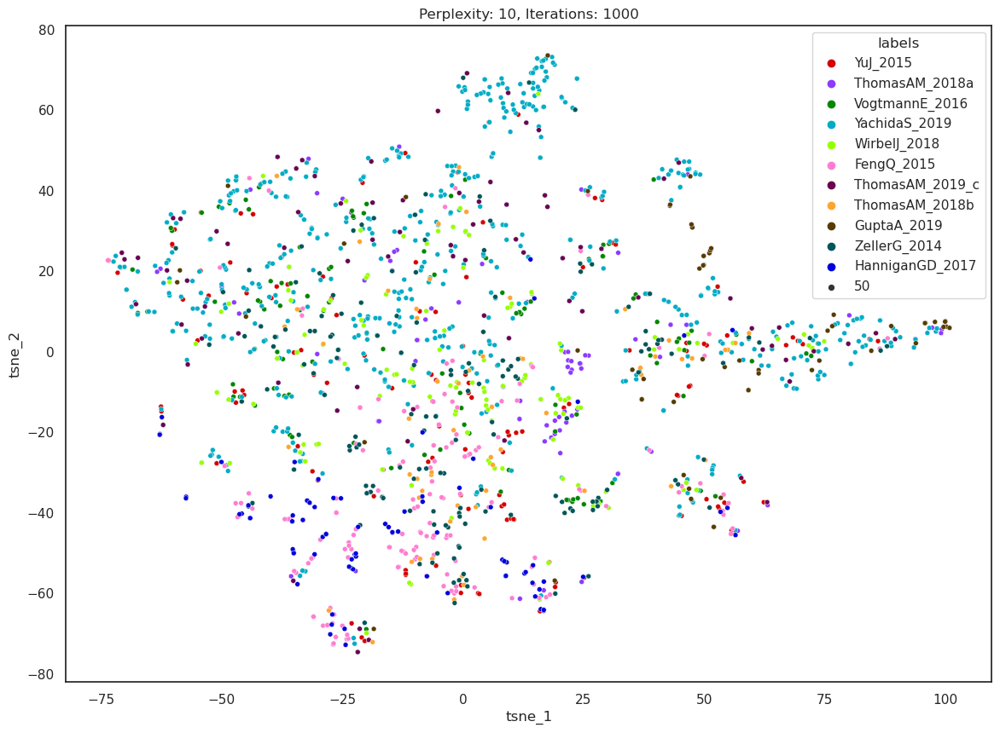

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

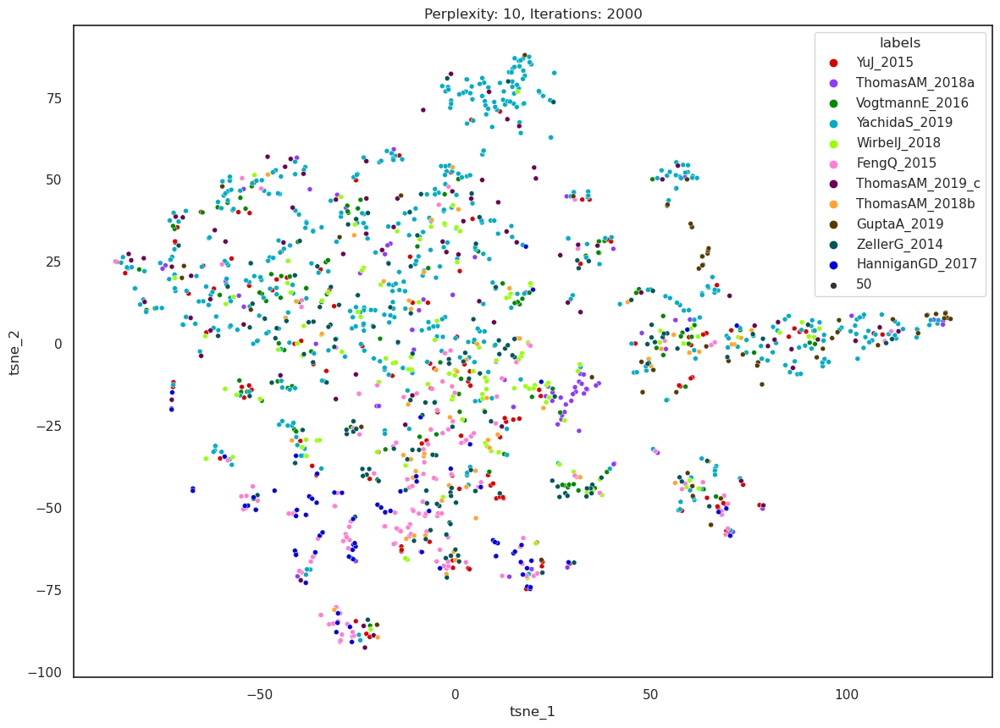

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

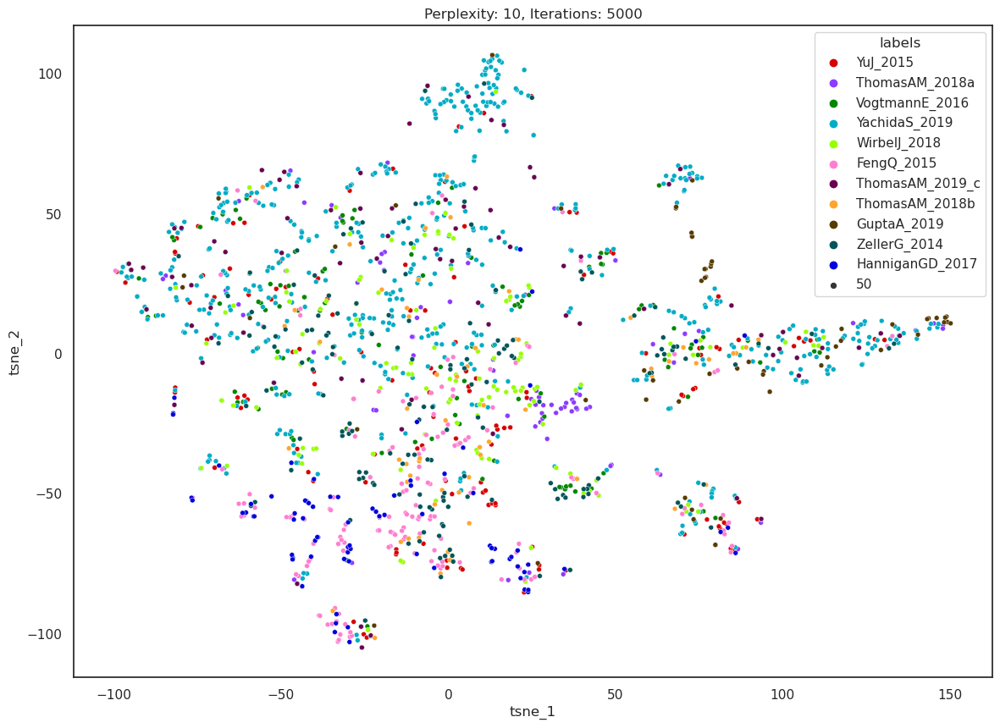

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

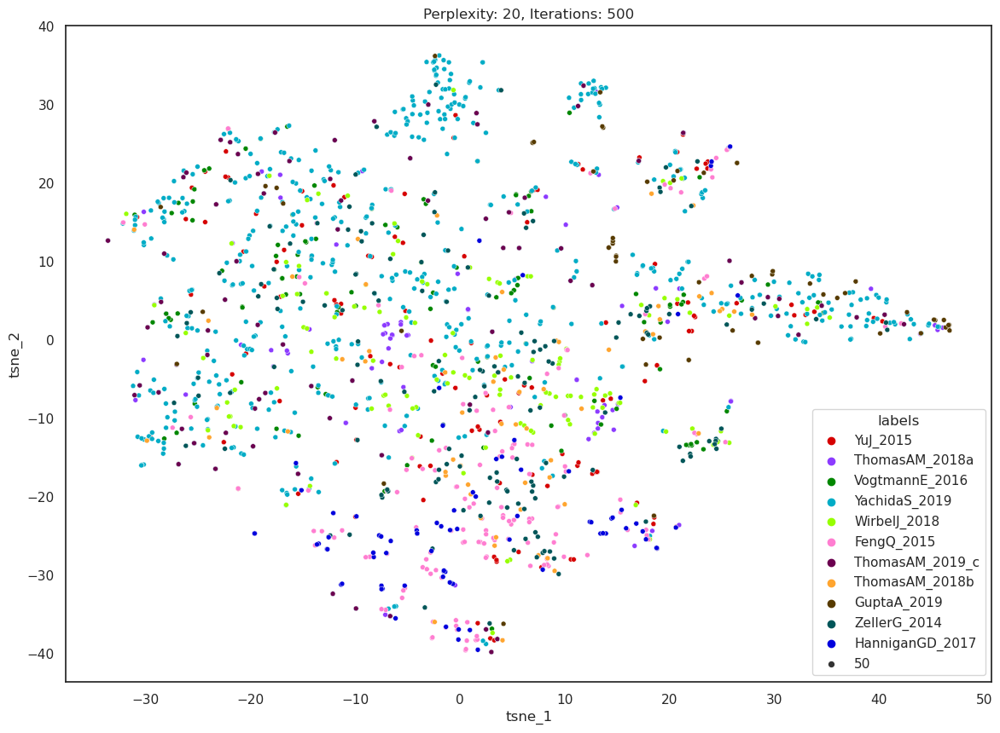

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

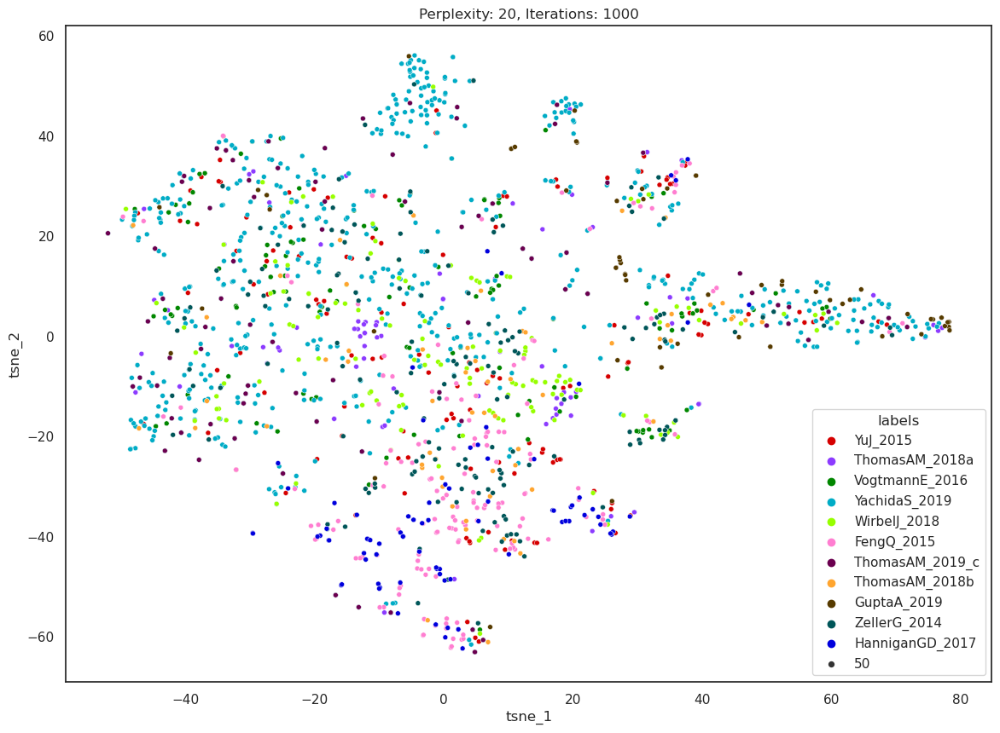

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

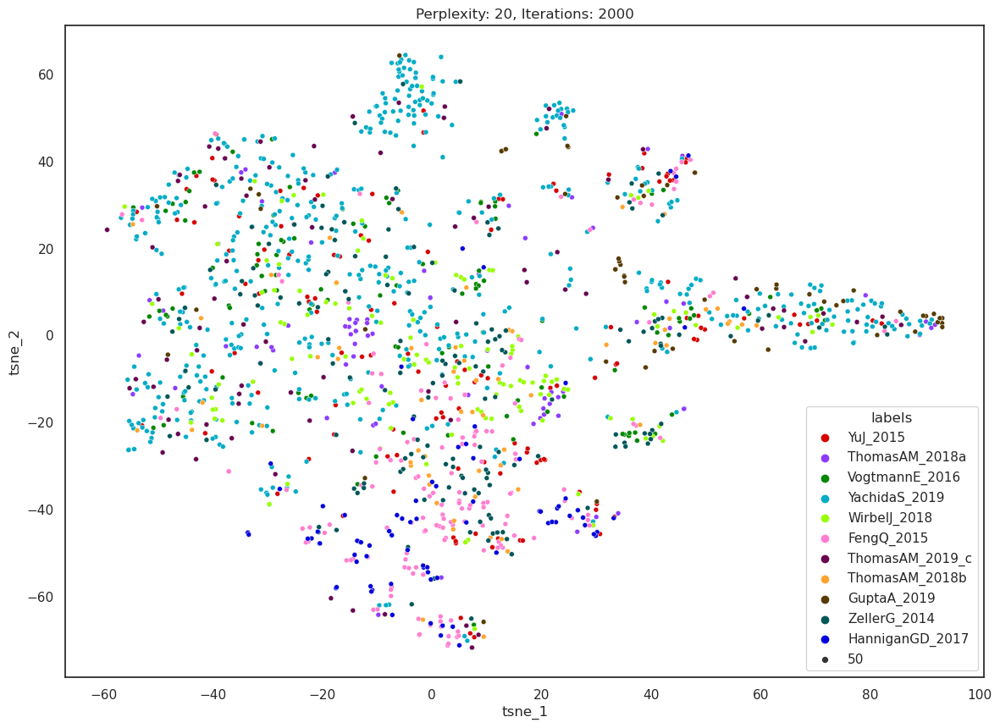

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

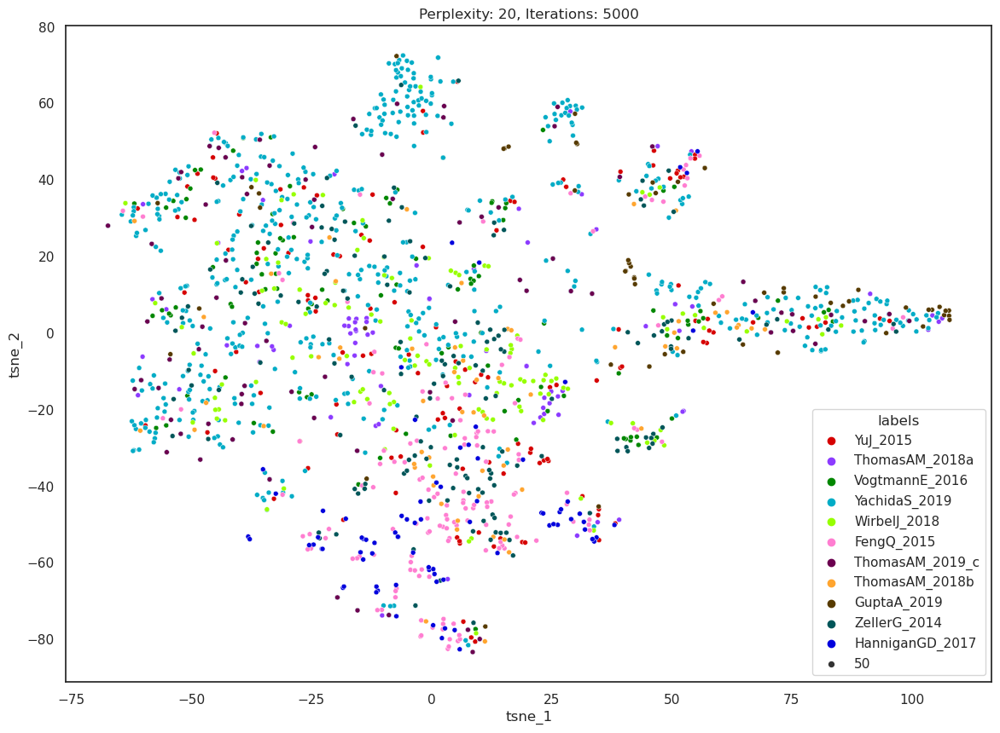

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

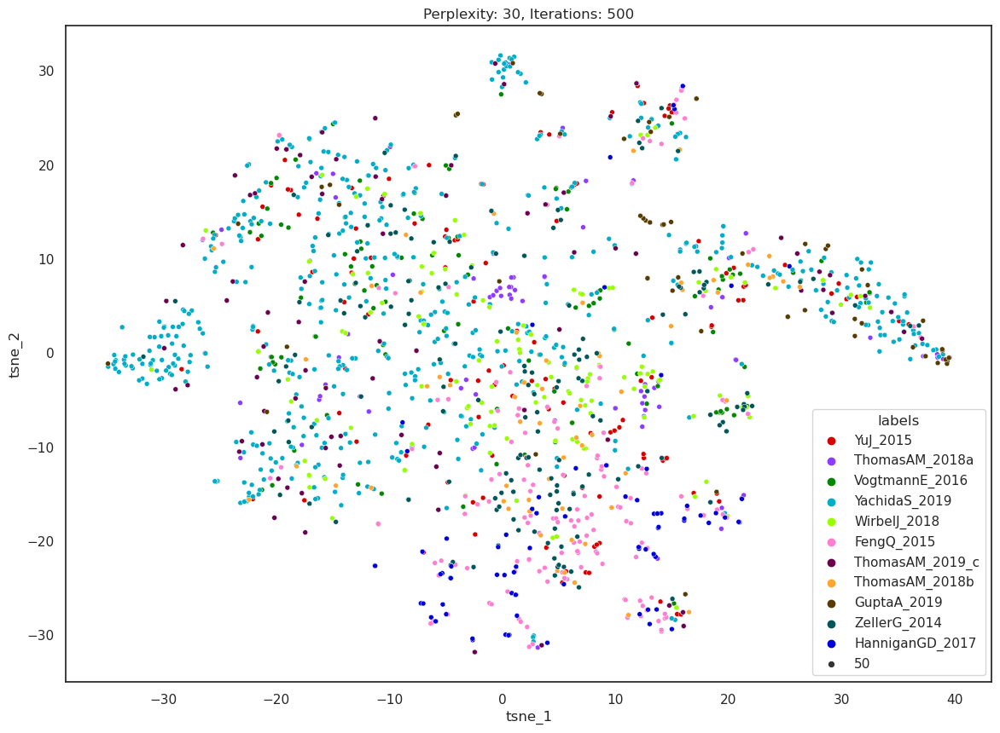

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

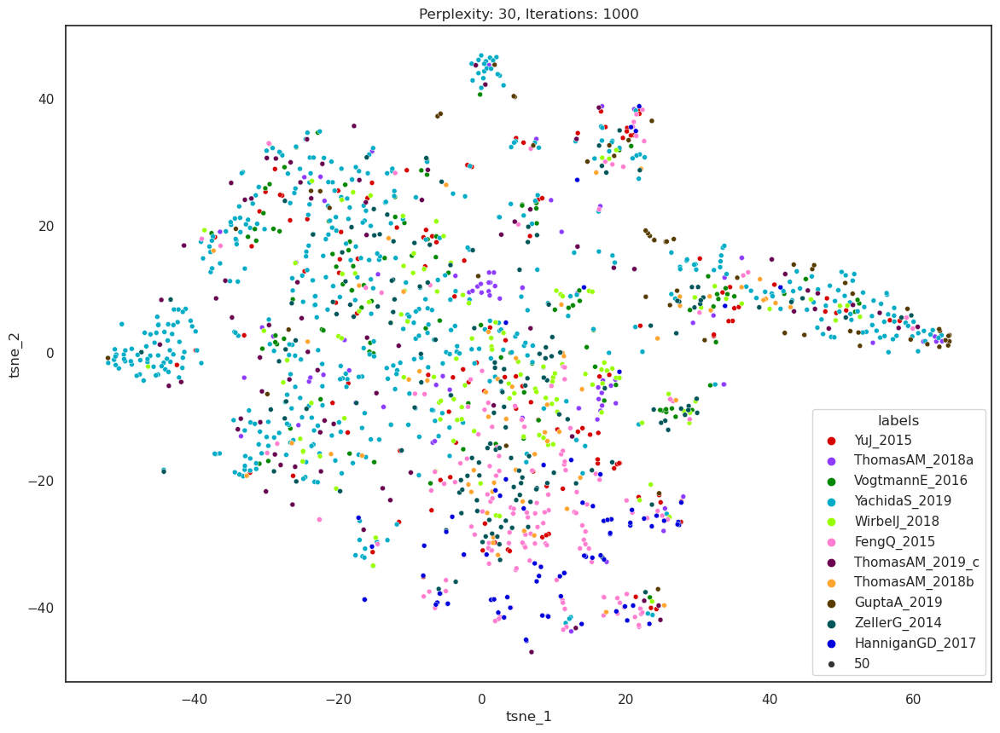

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

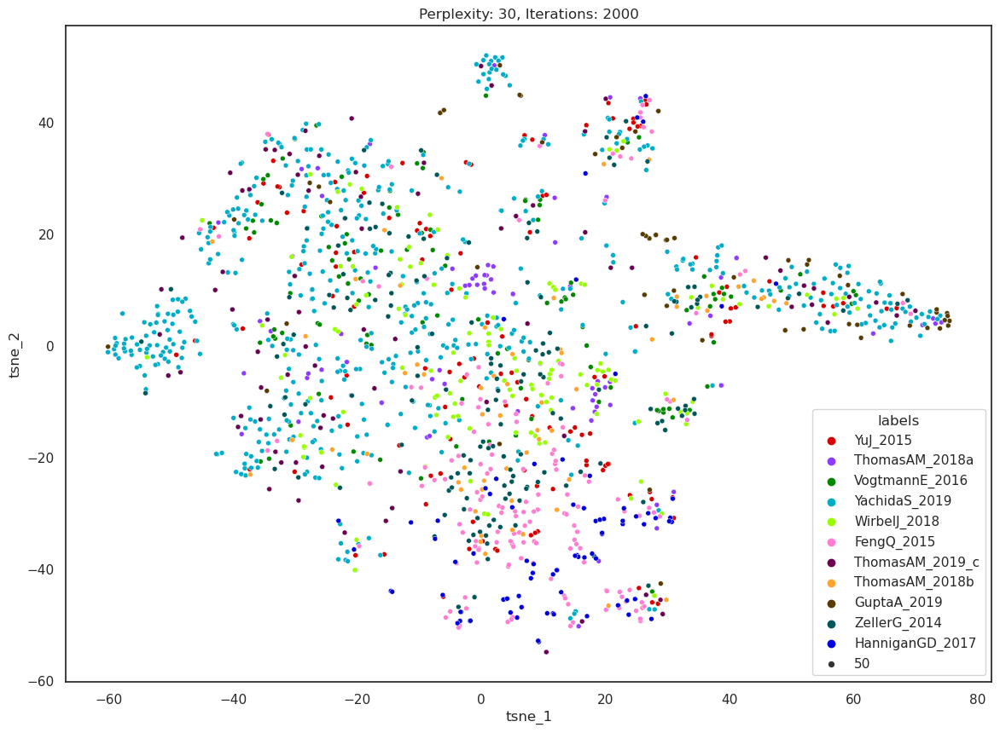

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

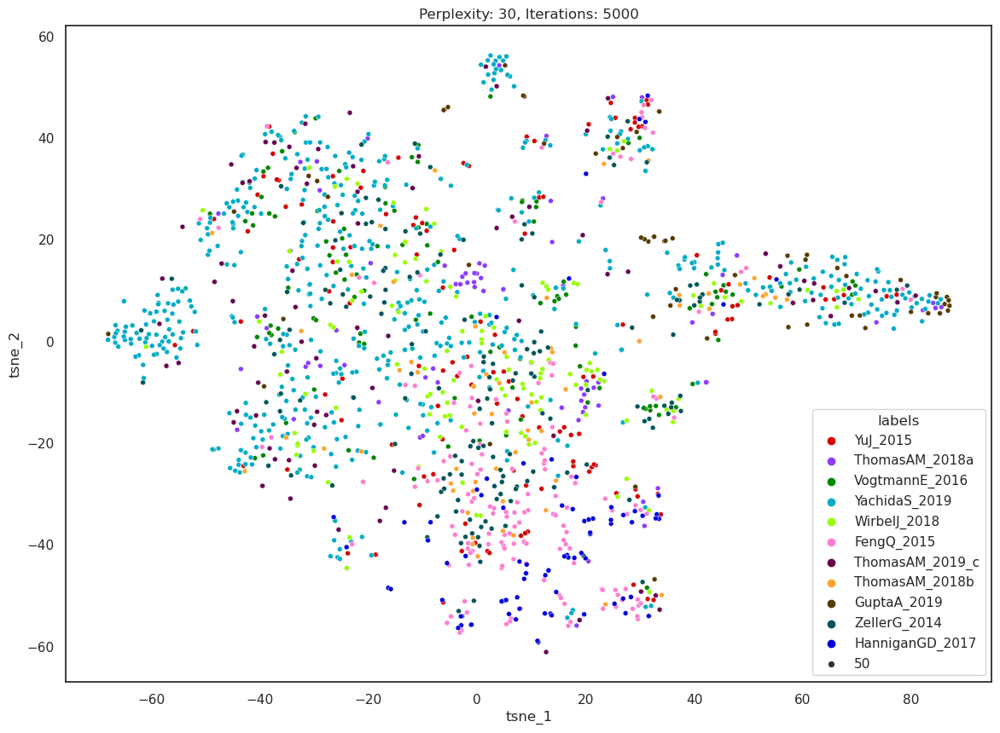

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

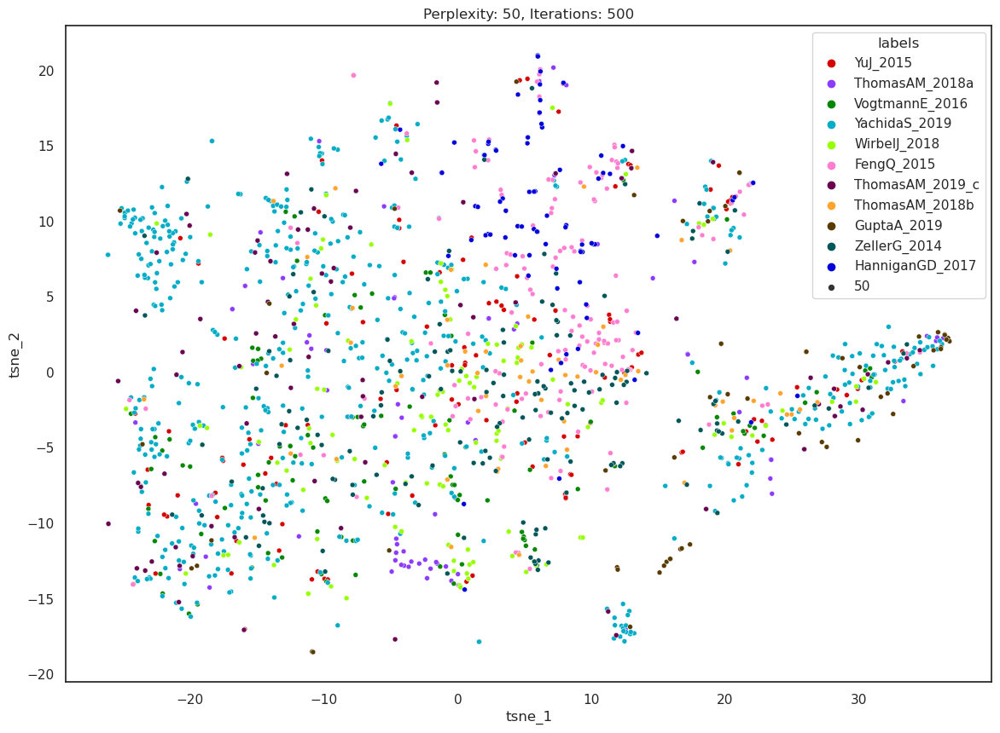

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

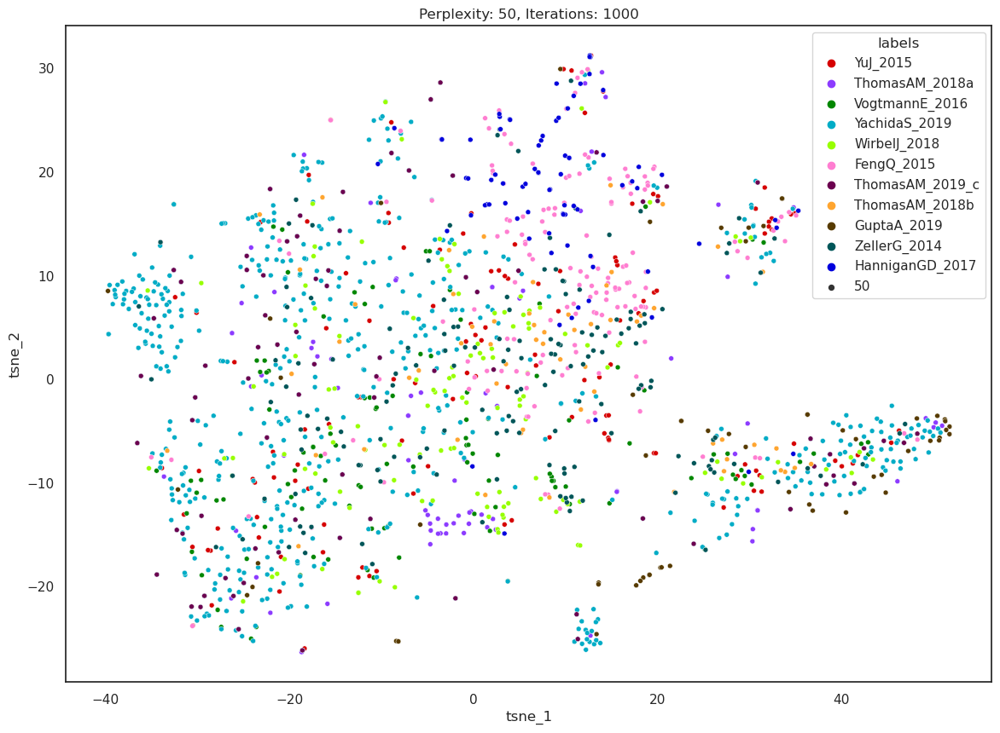

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

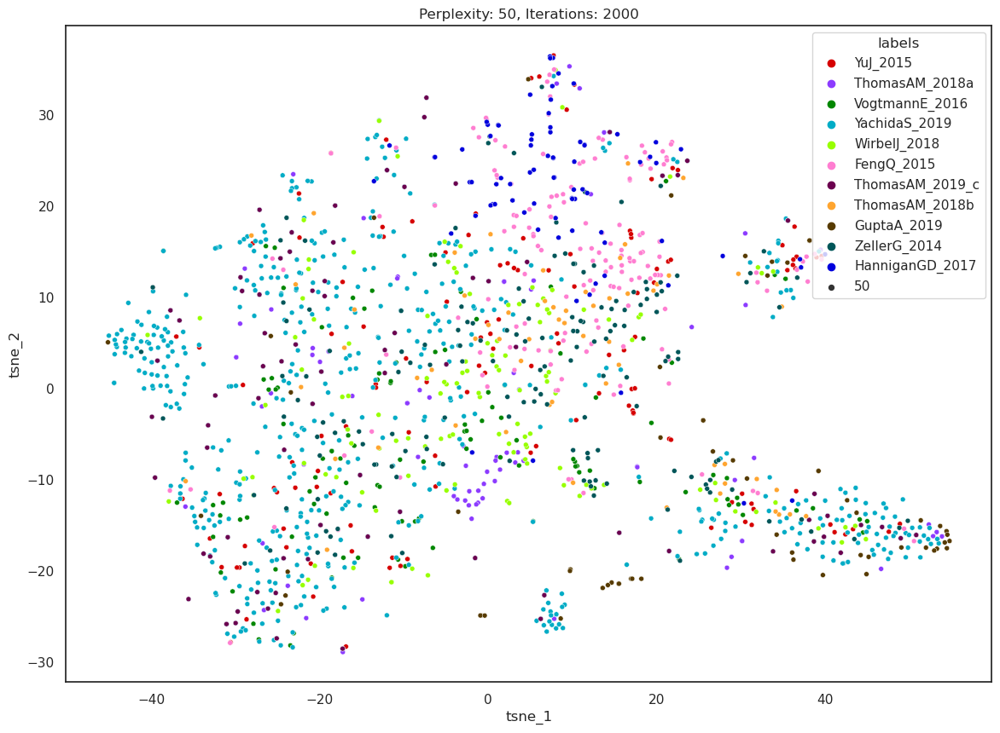

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

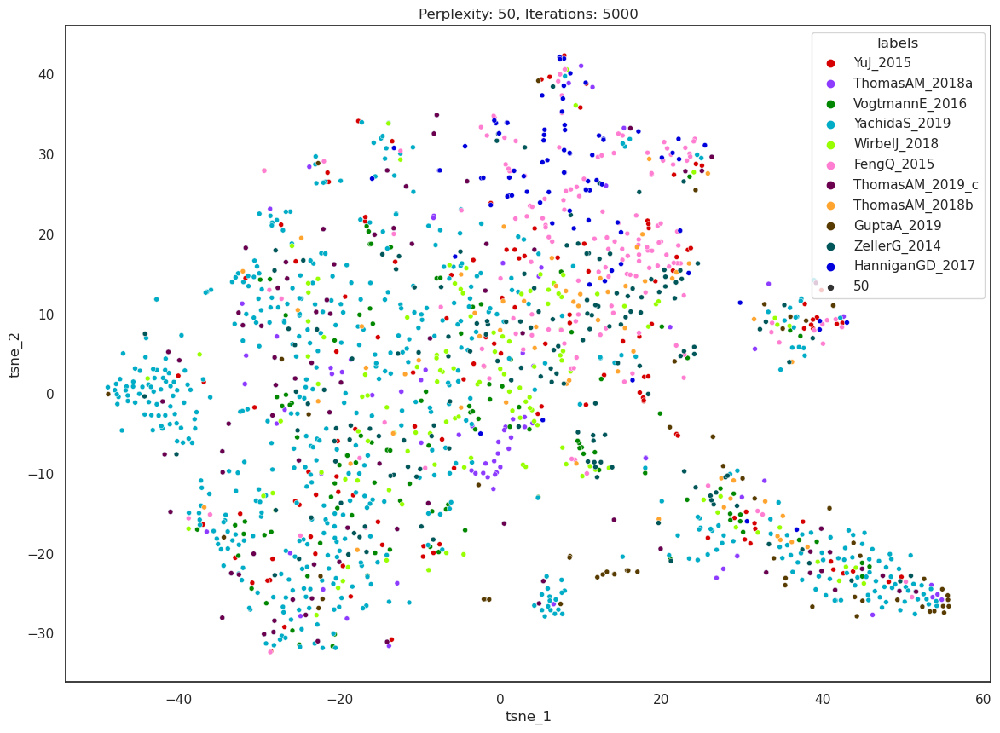

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


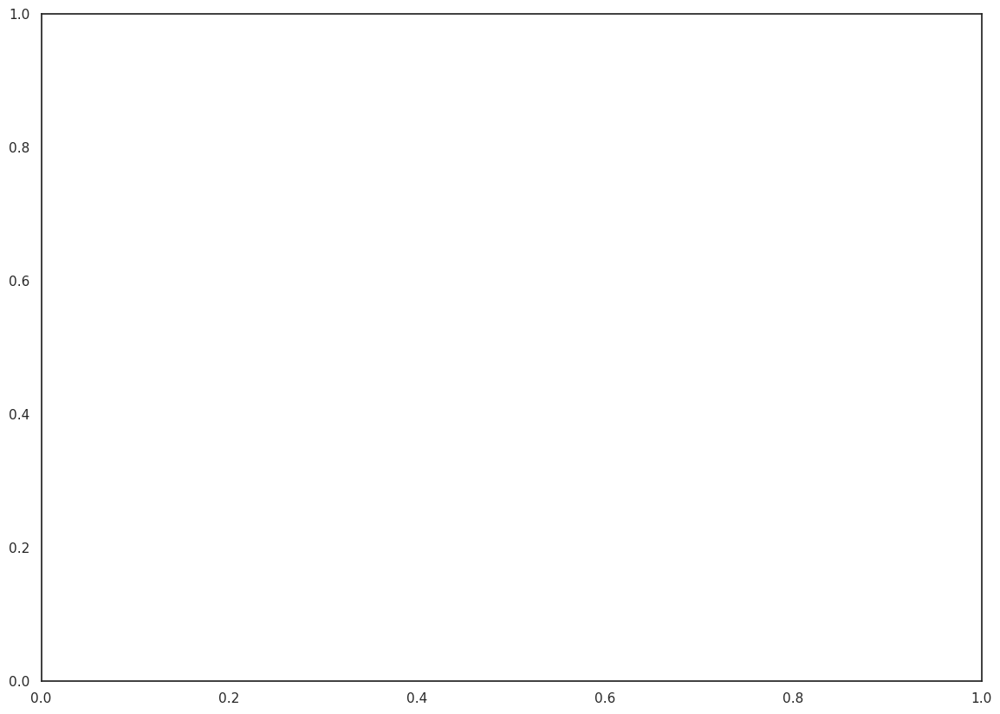

In [53]:
# test different perplexity and iteration values
# based on abundance, labeled by study

for i in (5, 10, 20, 30, 50):
    for j in (500, 1000, 2000, 5000):
        create_tsne_embedding(abundance_array, draw=True, labels=abundance_T.study_name.values, perplexity=i, n_iter=j)
        plt.legend().remove()
        

/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldc

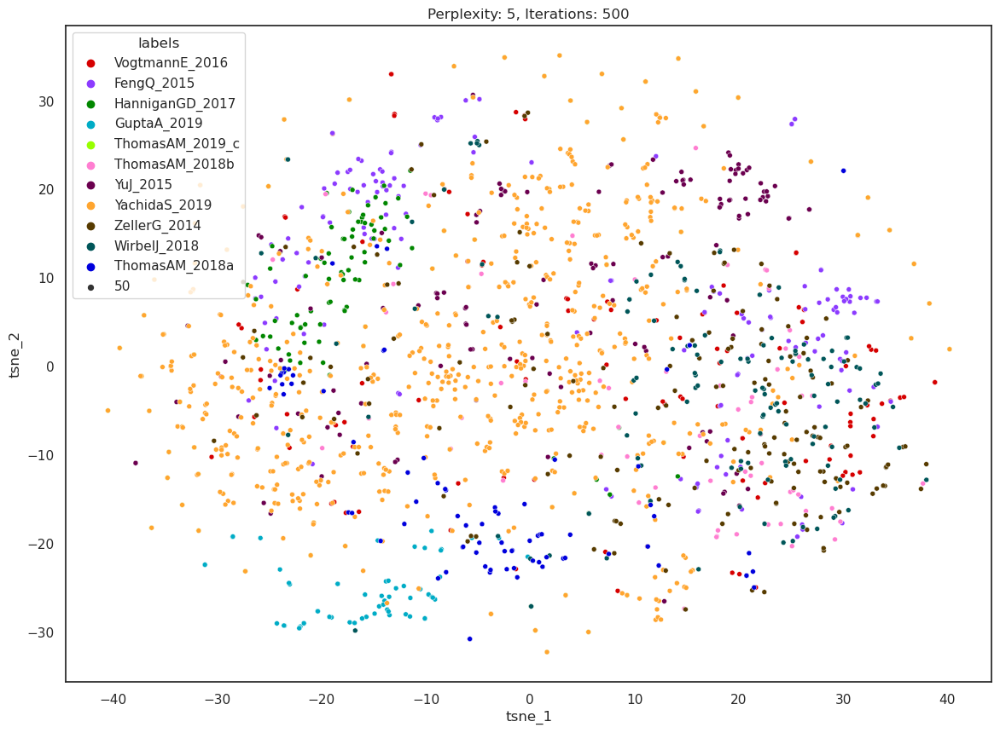

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

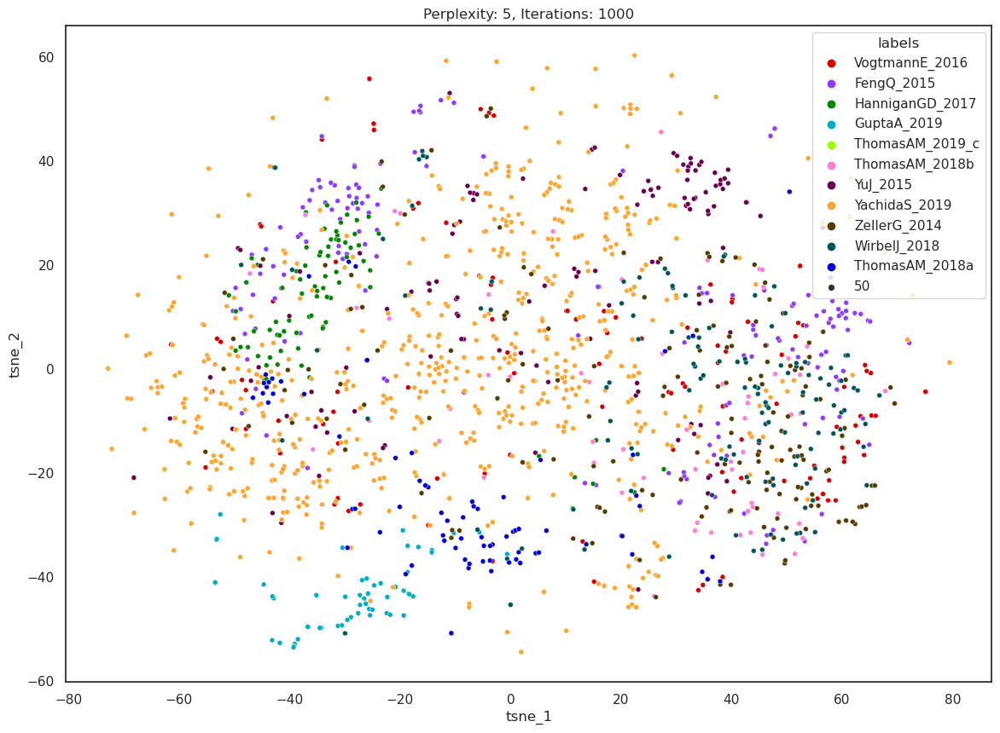

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

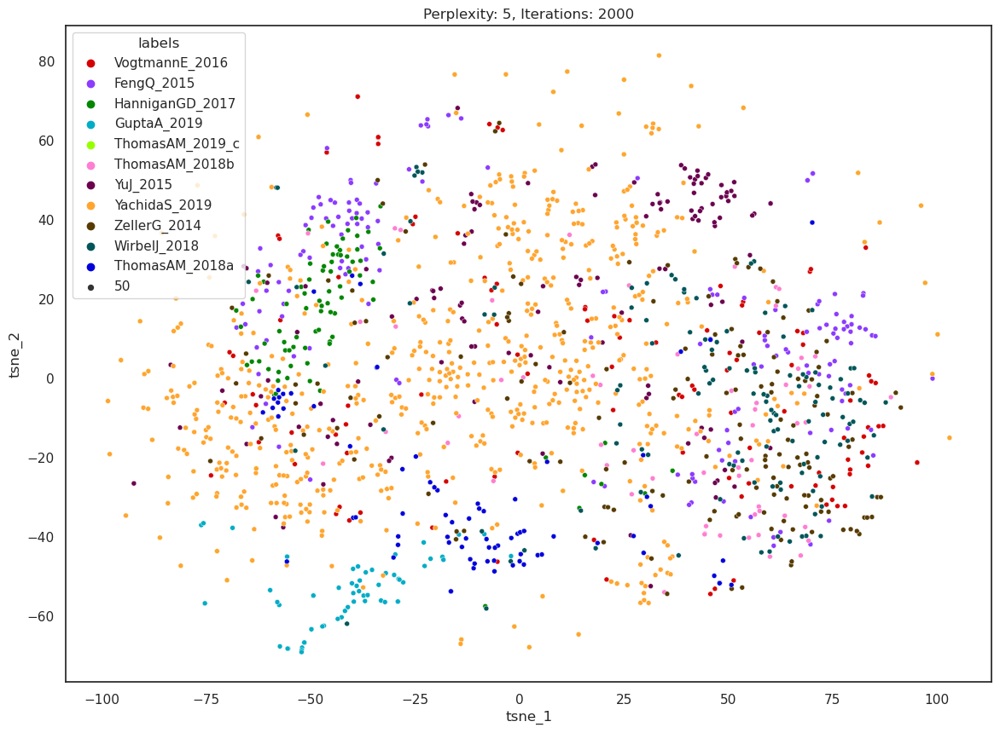

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

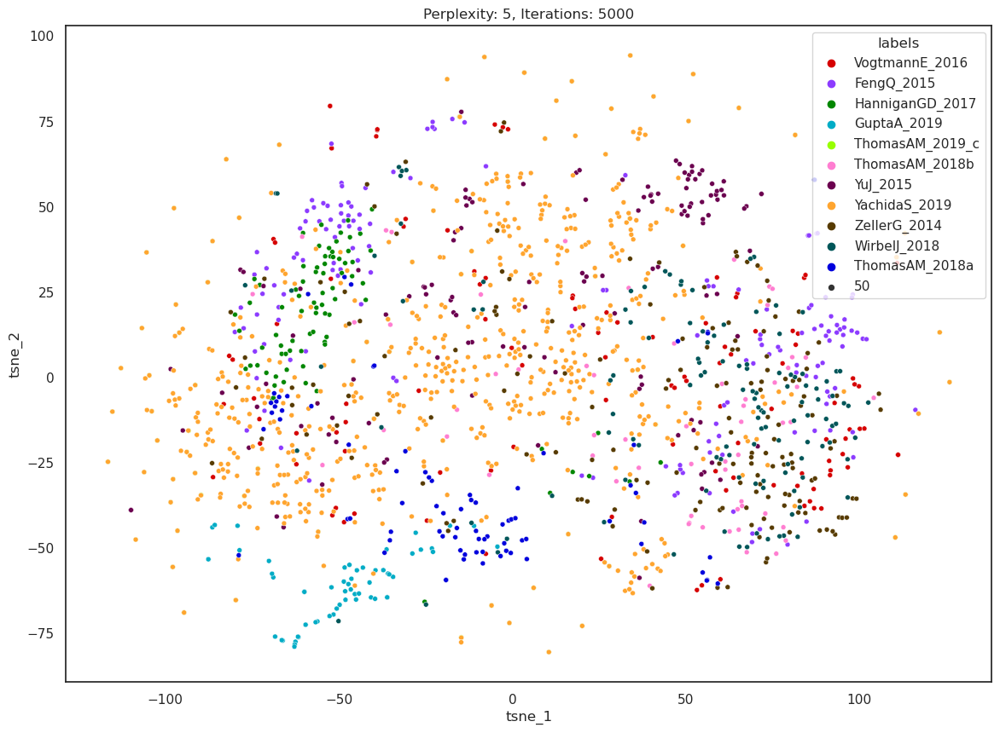

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

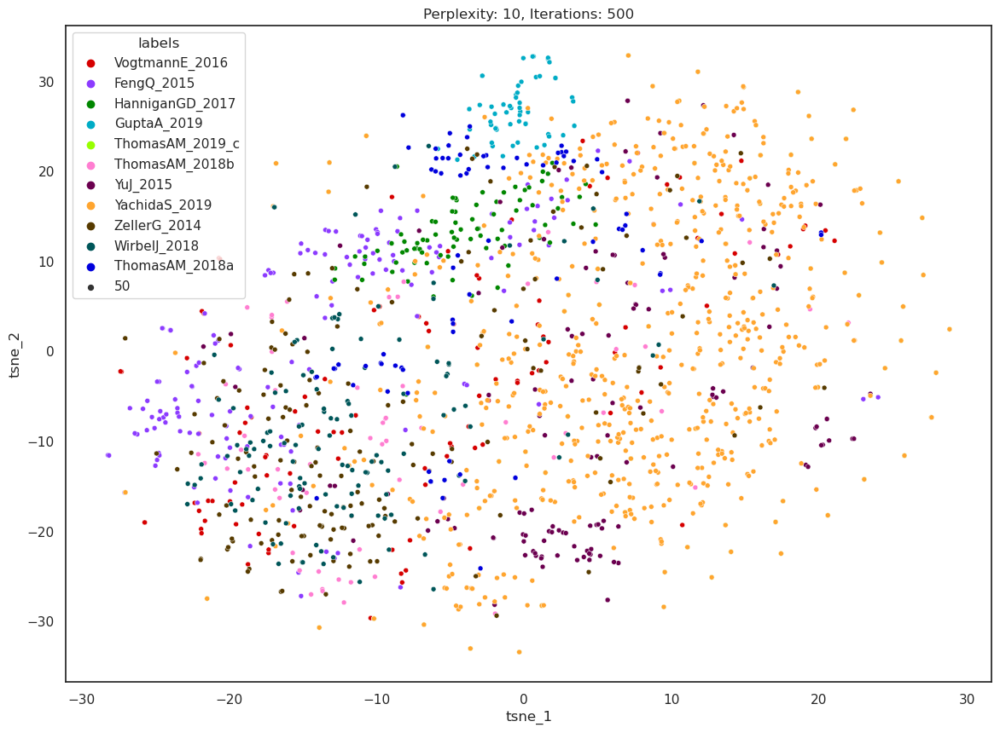

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

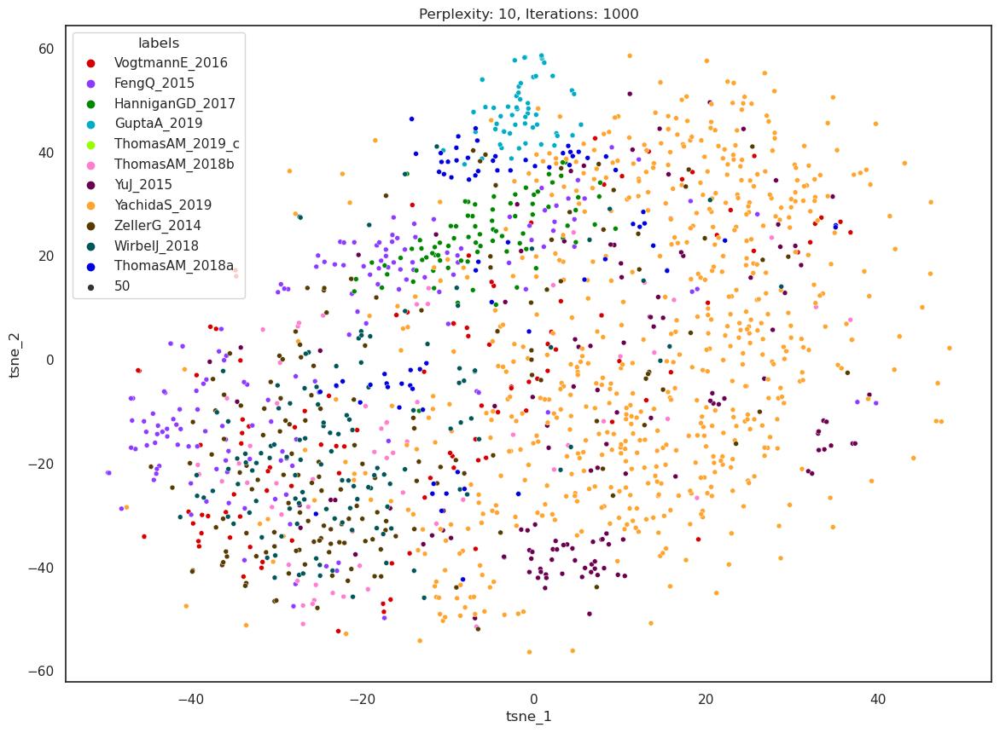

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

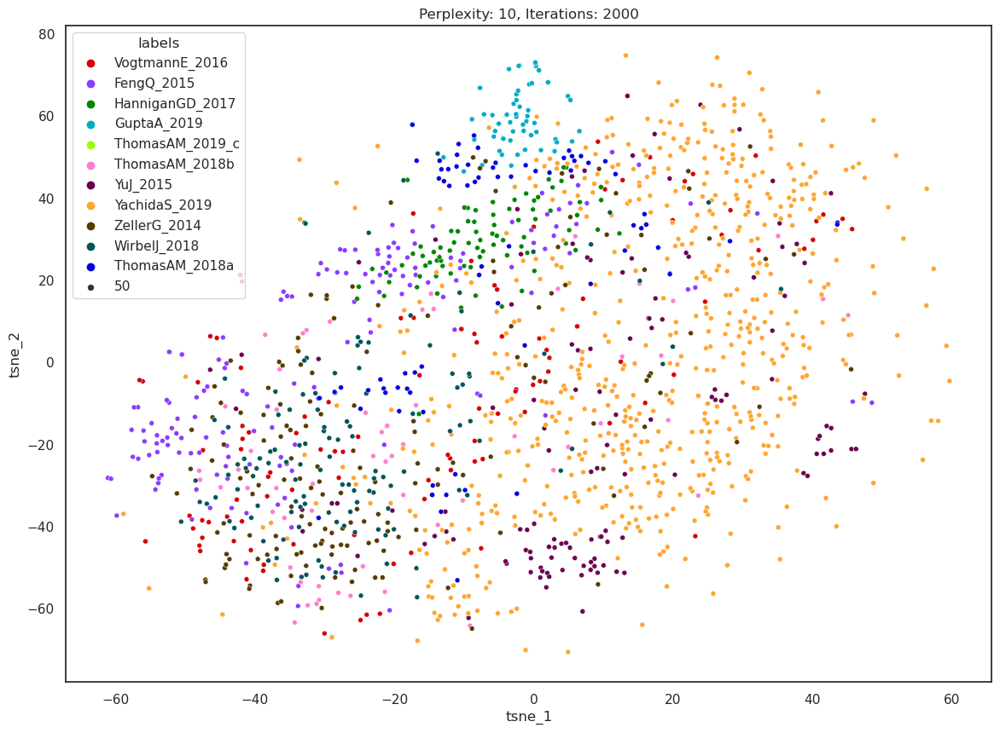

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

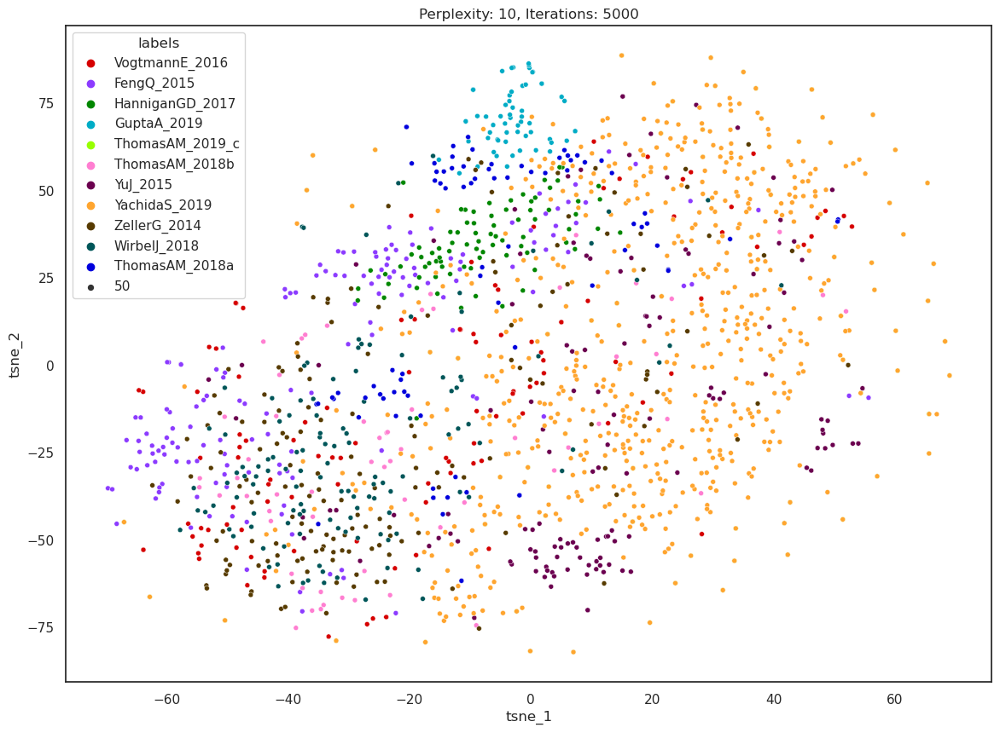

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

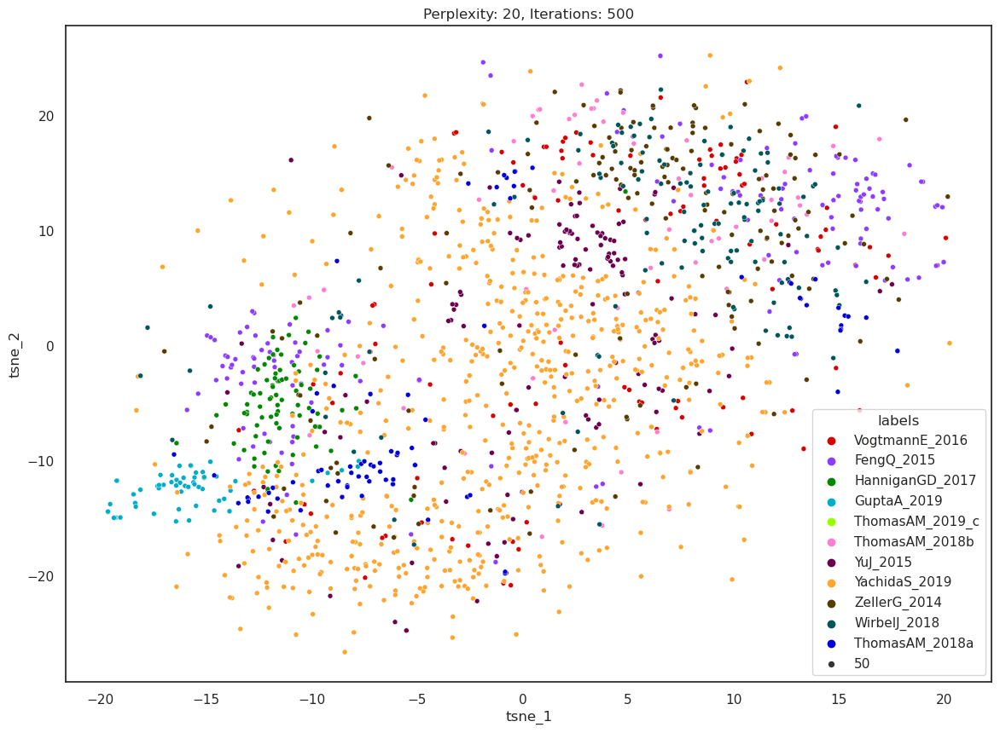

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

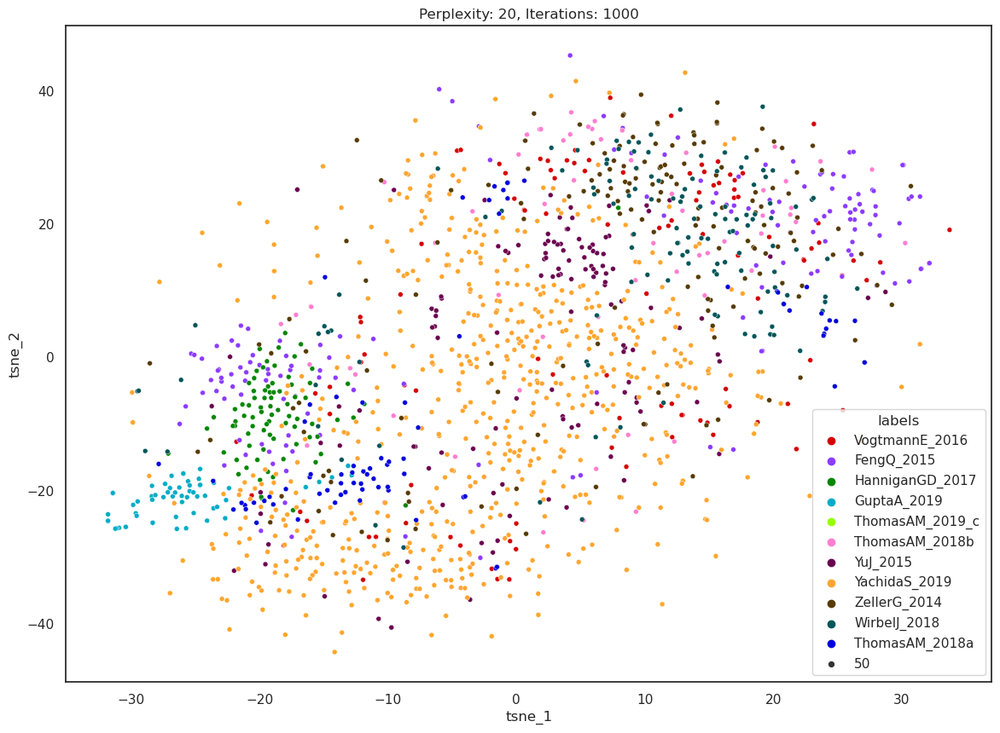

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

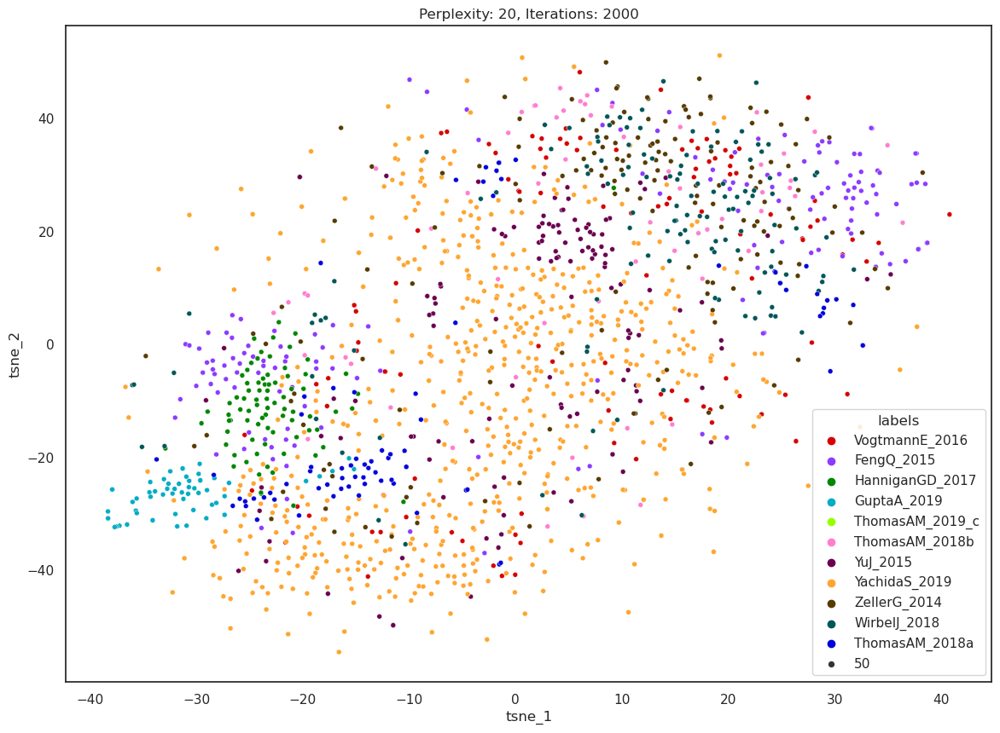

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

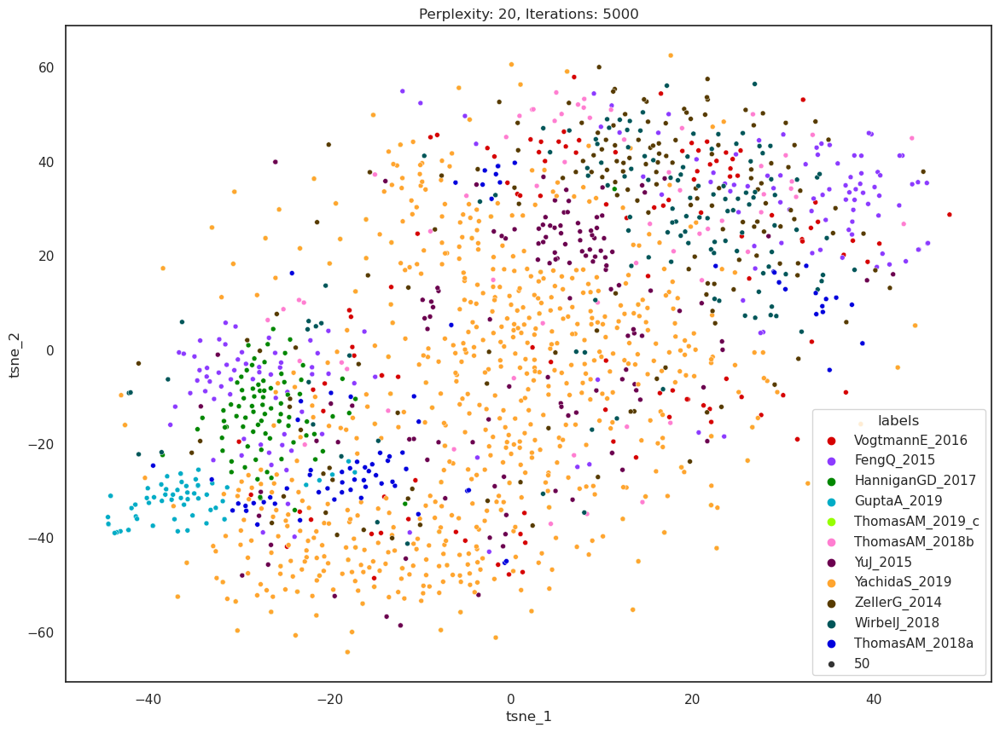

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

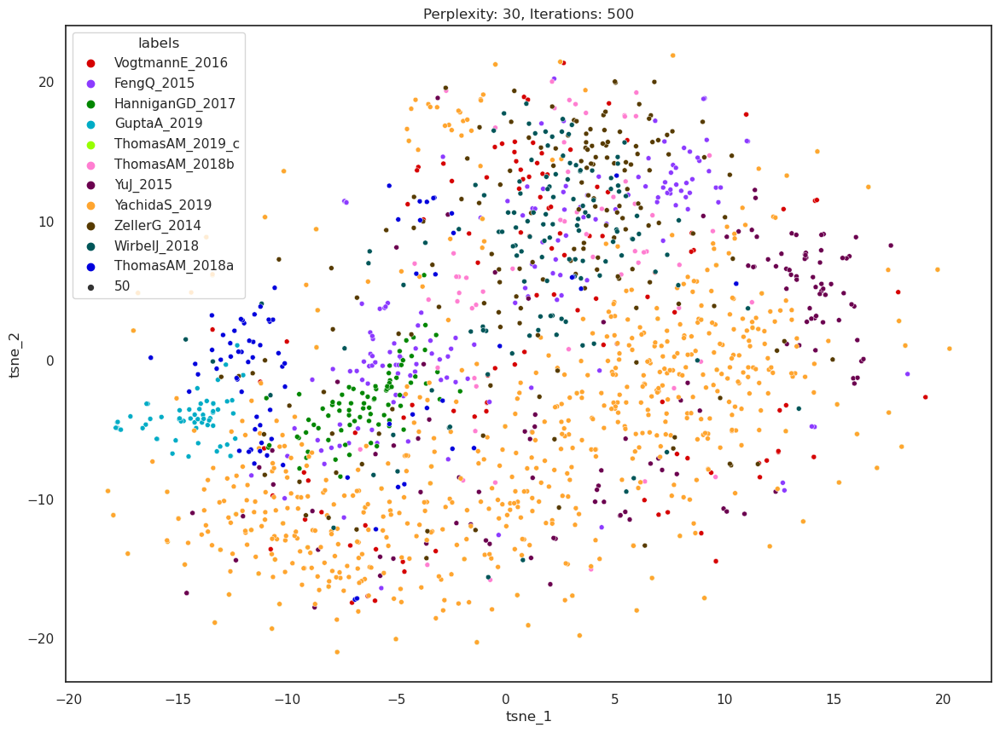

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

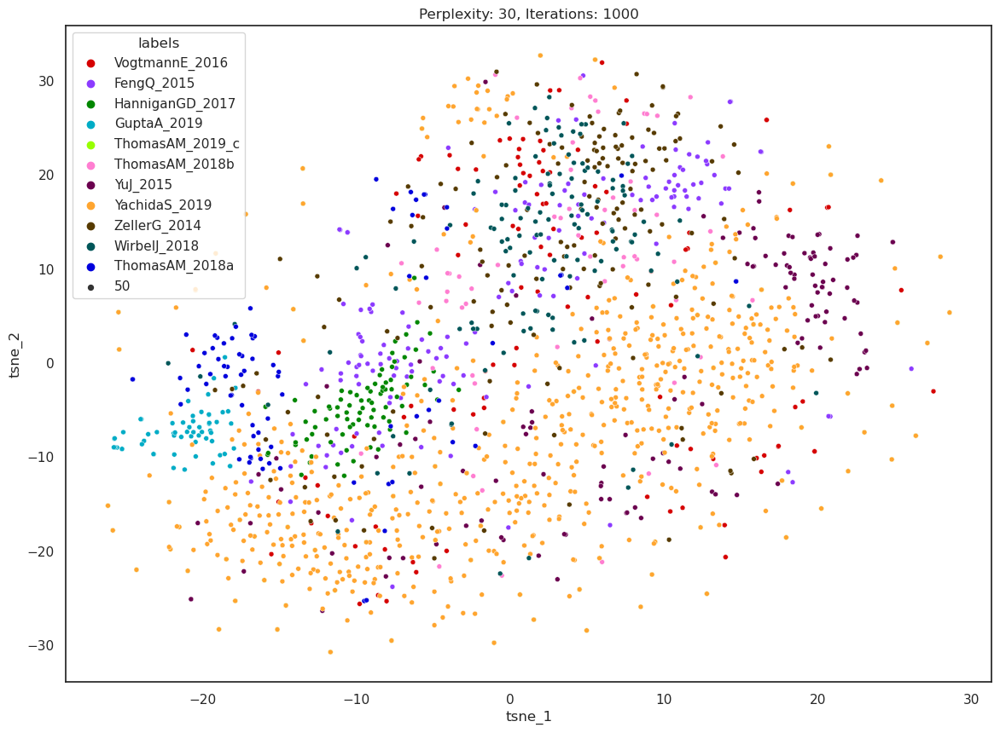

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

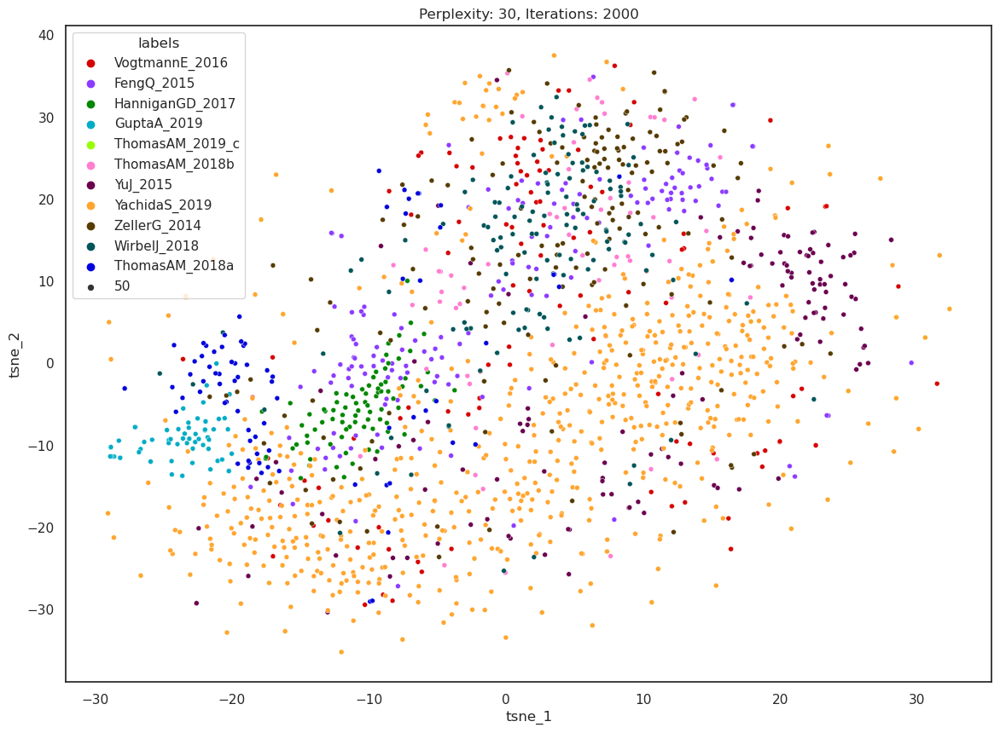

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

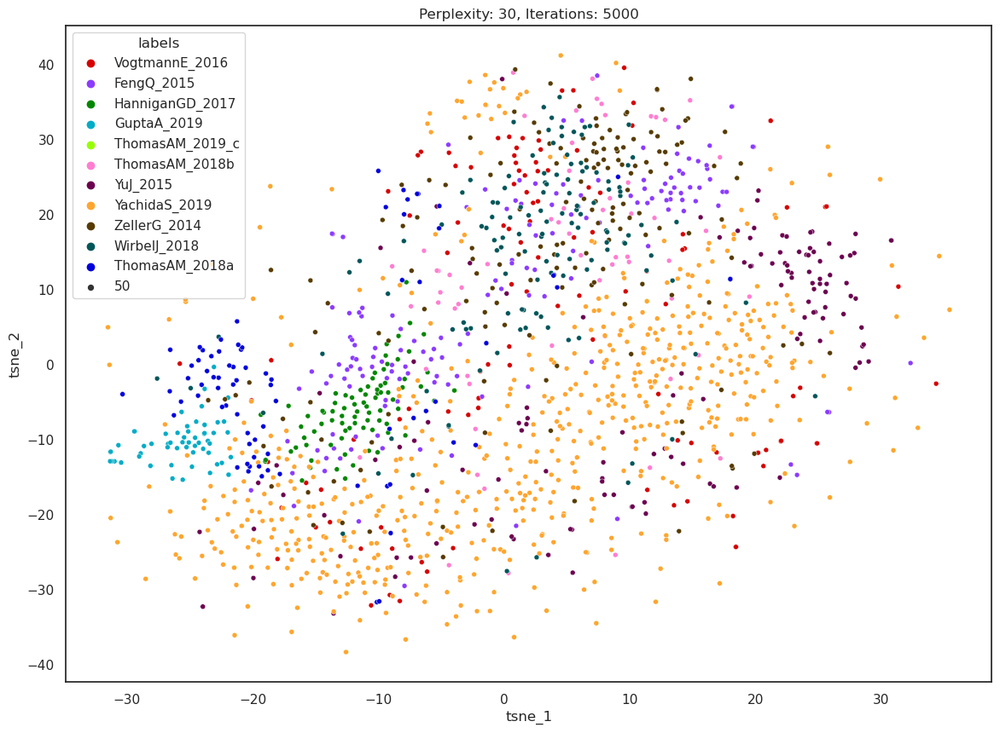

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

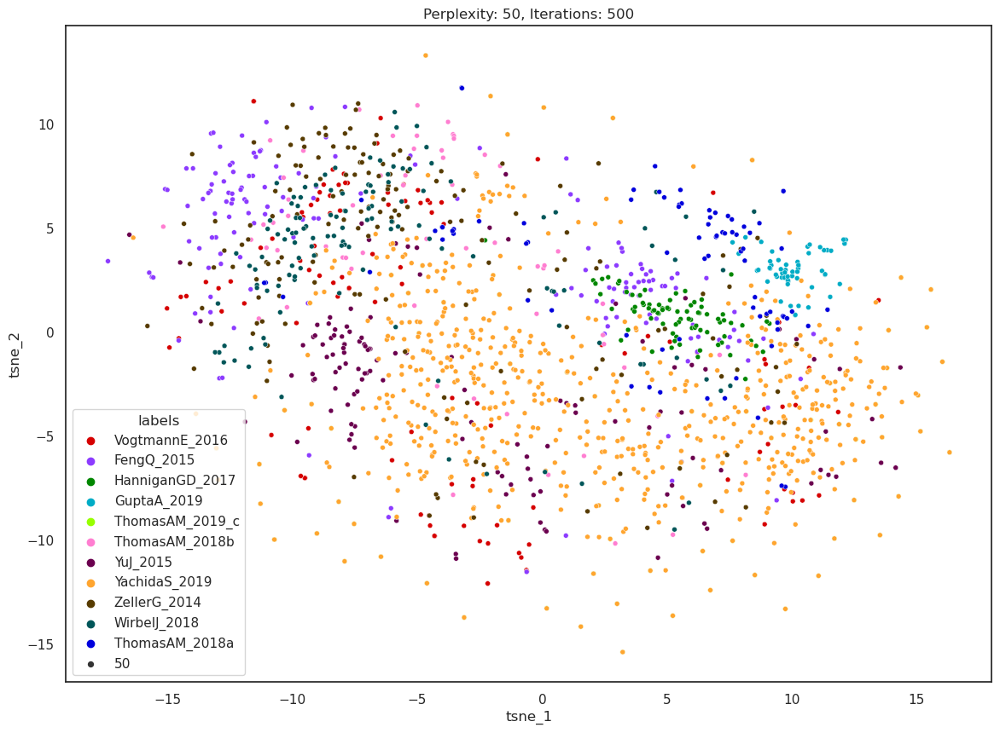

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

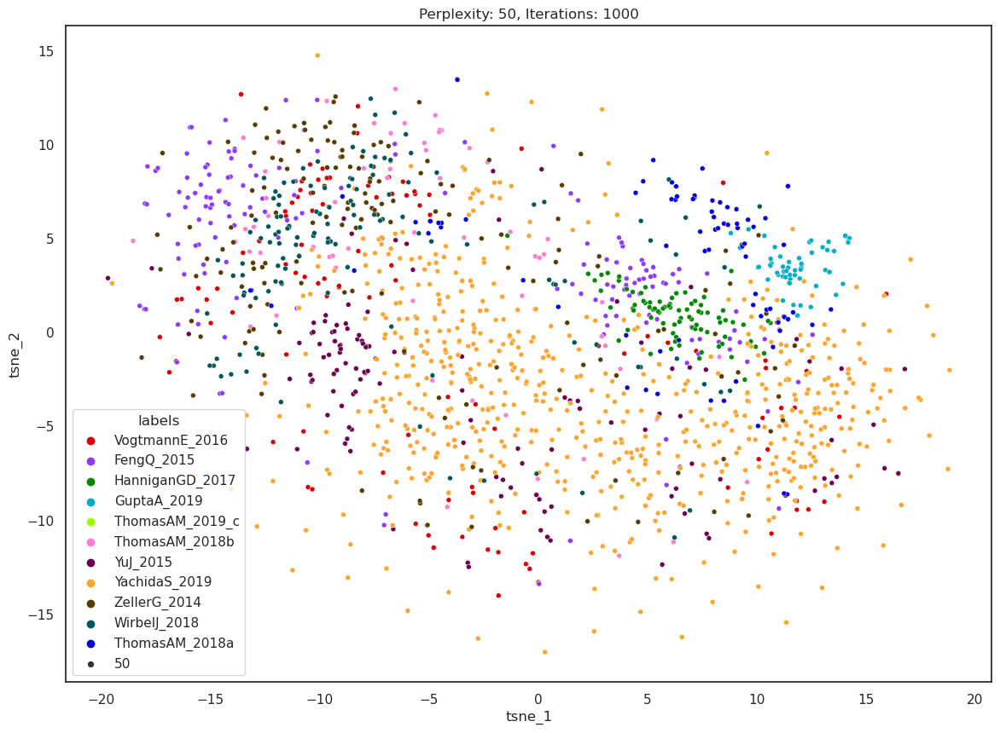

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

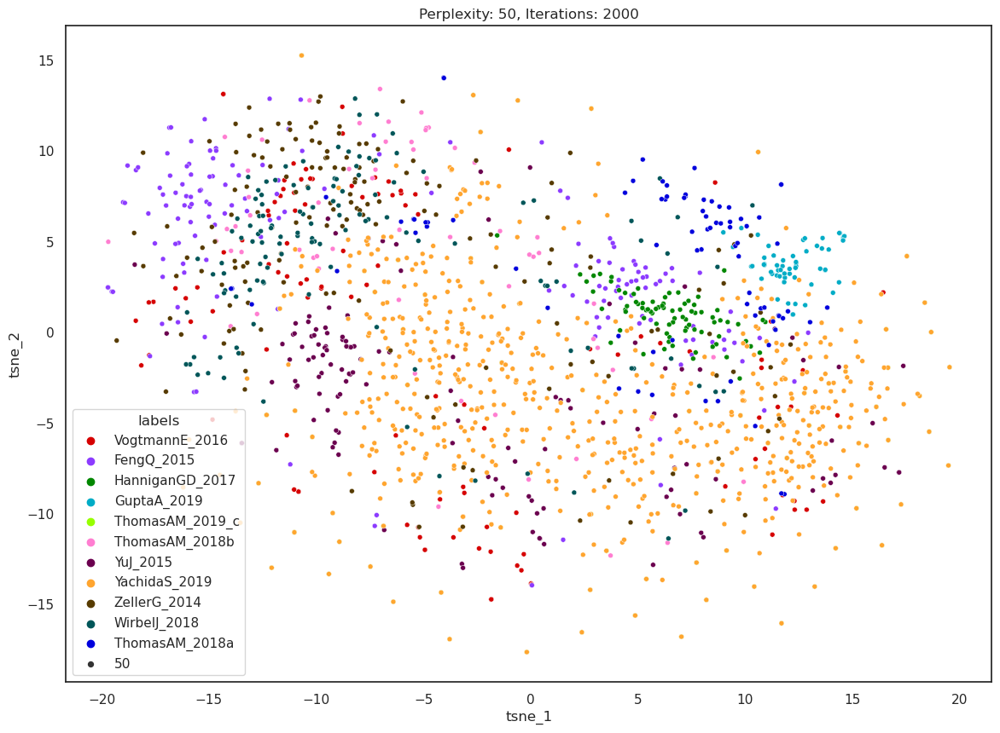

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype)

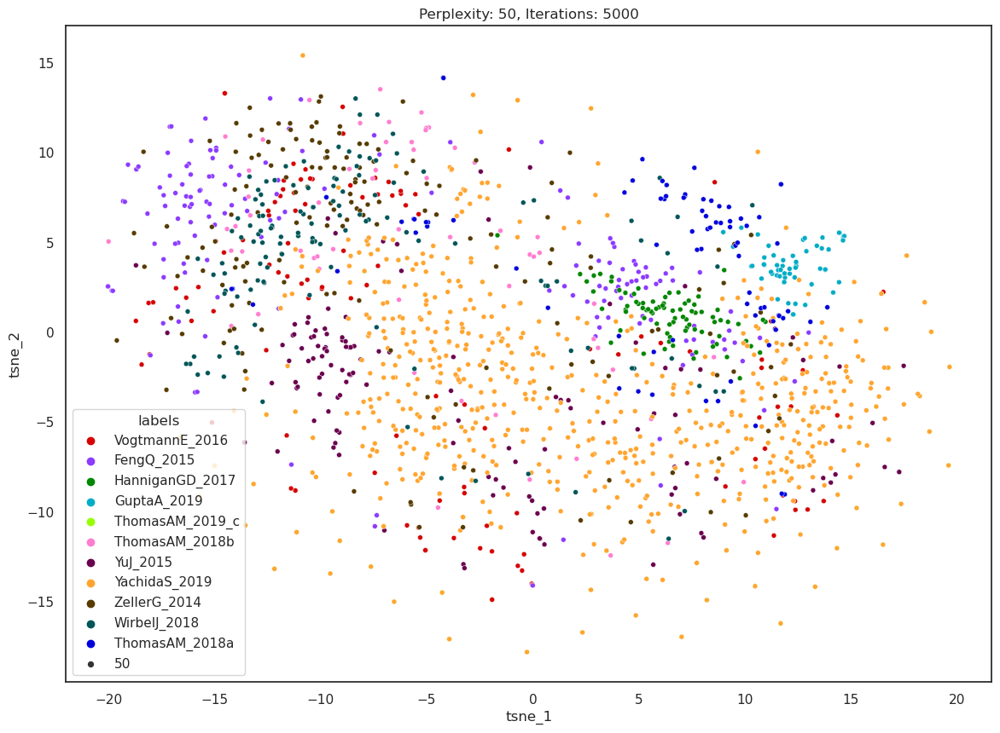

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


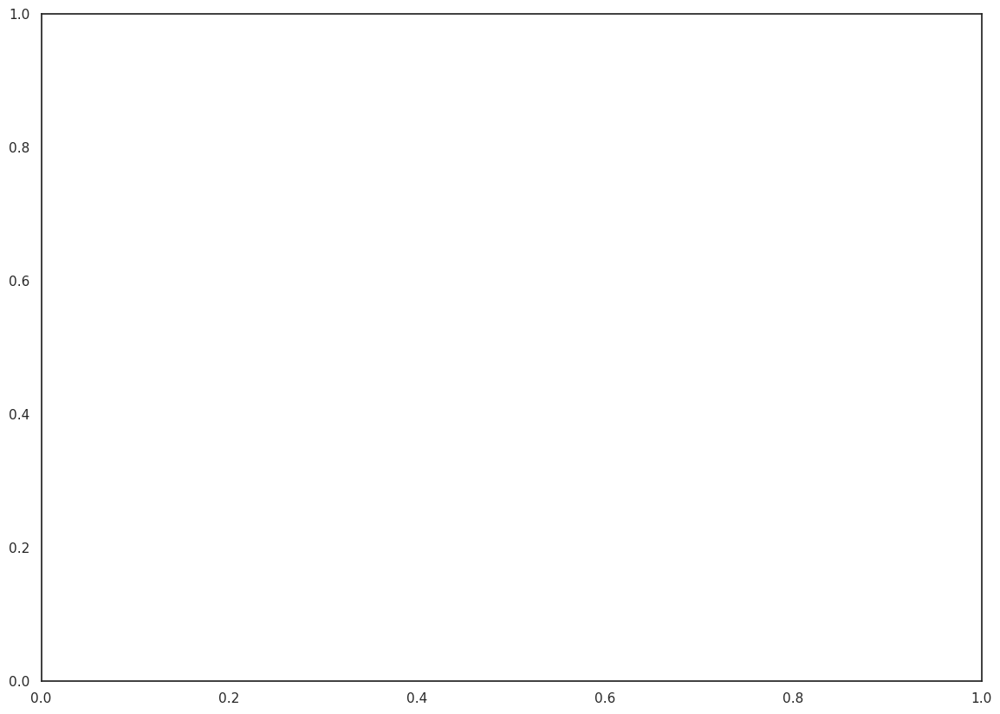

In [52]:
# test different perplexity and iteration values
# based on markers, labeled by study

for i in (5, 10, 20, 30, 50):
    for j in (500, 1000, 2000, 5000):
        create_tsne_embedding(marker_array, draw=True, labels=marker_T.study_name.values, perplexity=i, n_iter=j)
        plt.legend().remove()

## Final Embeddings

/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldc

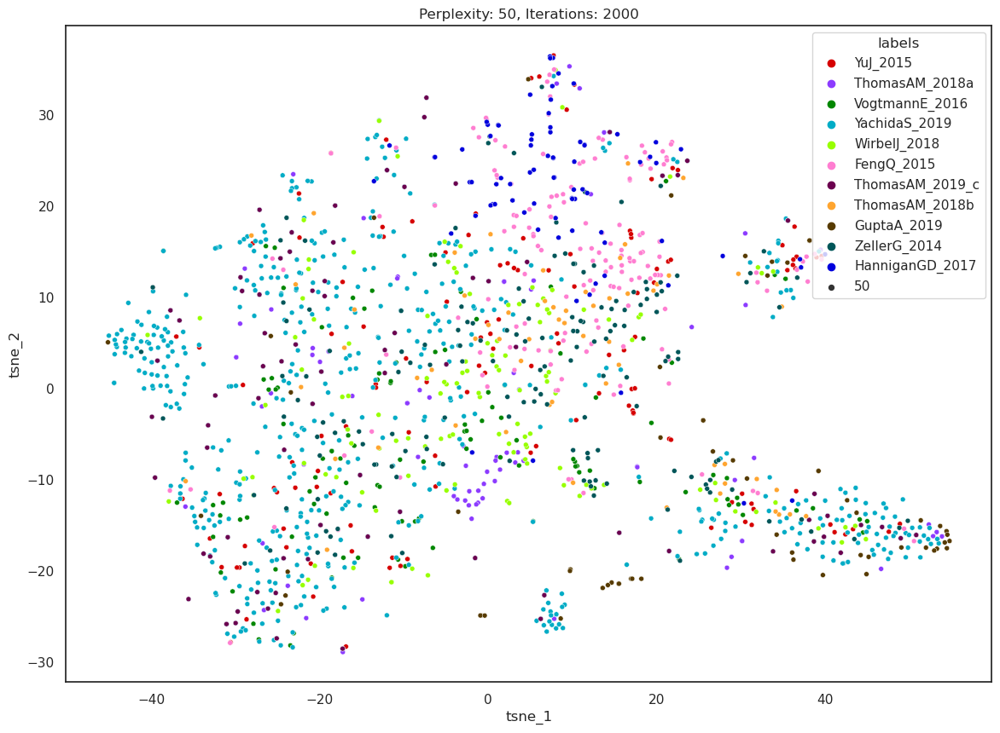

In [55]:
# final t-SNE embedding, based on abundance profiles
# labeled by study name

params = {
    "perplexity":50,
    "n_iter":2000
}

create_tsne_embedding(abundance_array, draw=True, labels=abundance_T.study_name.values, **params)

/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldc

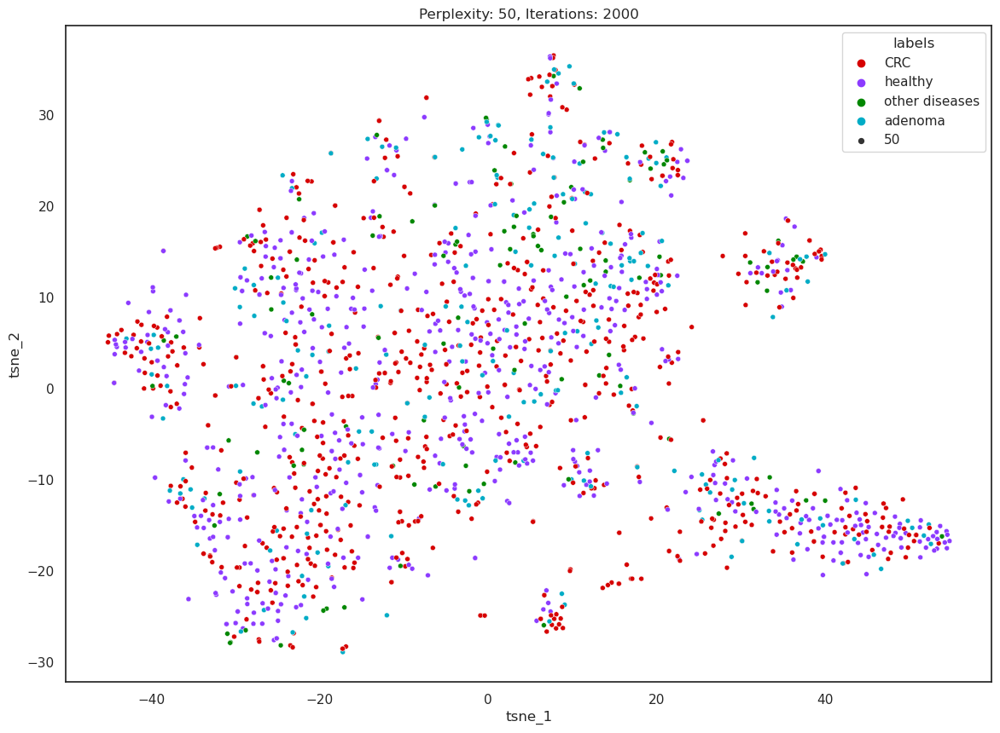

In [56]:
# final t-SNE embedding, based on abundance profiles
# labeled by disease

params = {
    "perplexity":50,
    "n_iter":2000
}

create_tsne_embedding(abundance_array, draw=True, labels=abundance_T.disease.values, **params)

/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldc

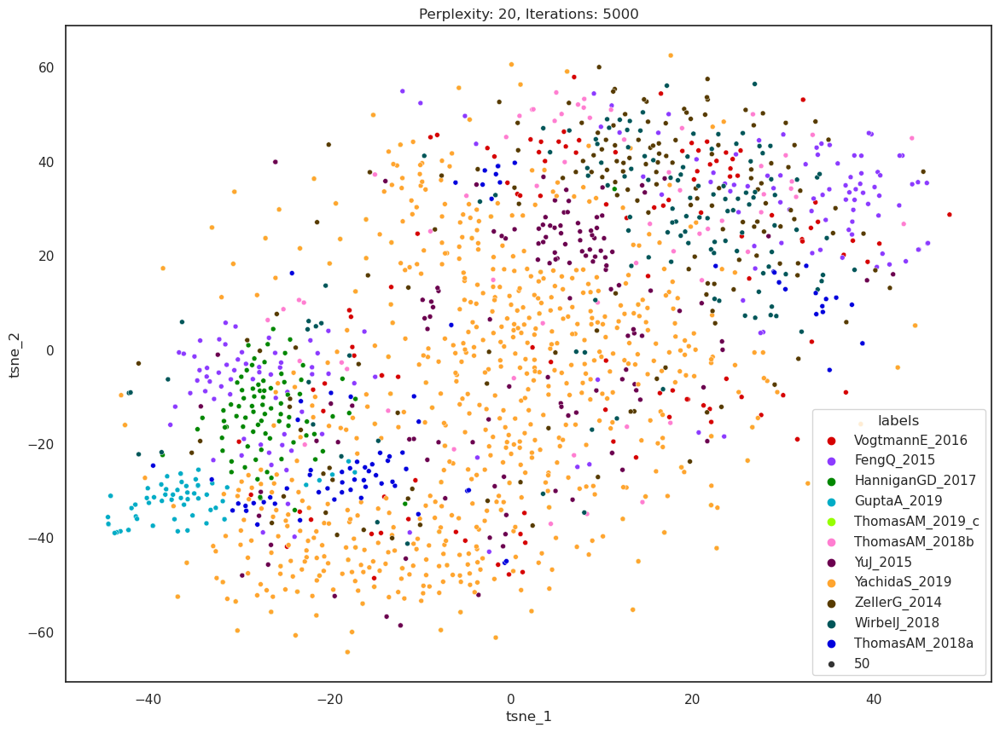

In [57]:
# final t-SNE embedding, based on markers
# labeled by study name

params = {
    "perplexity":20,
    "n_iter":5000
}

create_tsne_embedding(marker_array, draw=True, labels=marker_T.study_name.values, **params)

/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/nle-mvonstetten/miniconda3/envs/analyse_data_python/lib/python3.11/site-packages/seaborn/_oldc

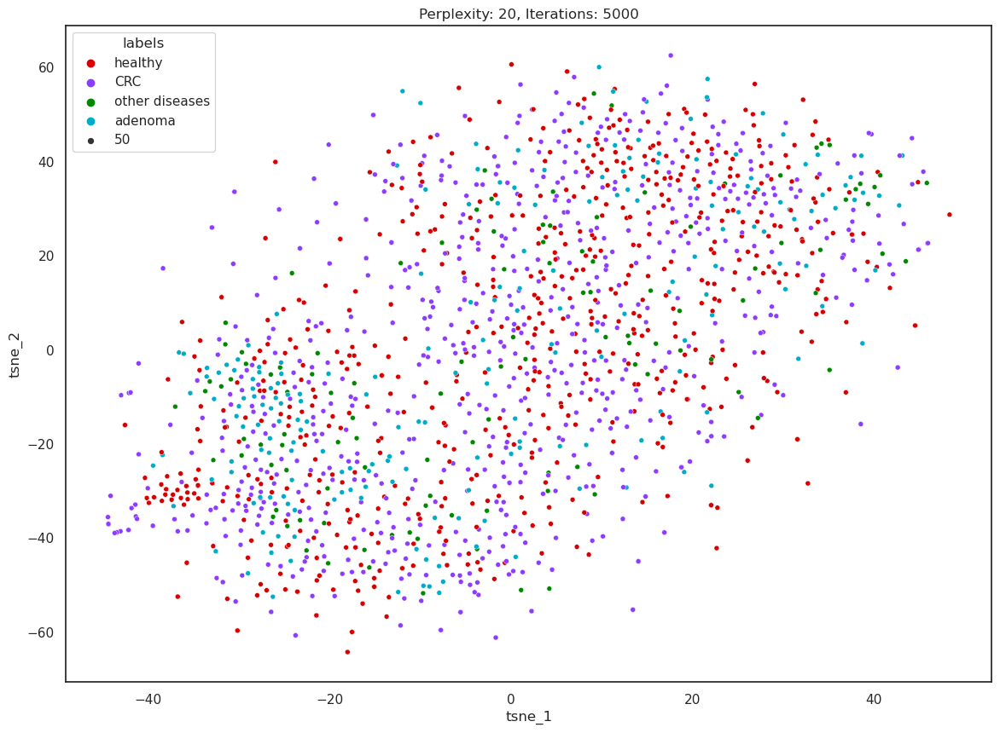

In [58]:
# final t-SNE embedding, based on markers
# labeled by disease

params = {
    "perplexity":20,
    "n_iter":5000
}

create_tsne_embedding(marker_array, draw=True, labels=marker_T.disease.values, **params)